# Capstone Project - Sprint 2

## Zaid Al-Jawadi

# Introduction

The goal of this capstone project is to identify CO2 emissions in g/km using car features. The dataset used is from the Government of Canada, which includes car models available in Canada from 1995 - 2023. The features of the dataset are outlined below in the data dictinoary. CO2 emissions are derived from fuel consumption of a car. I have always been curious about the differences in fuel consumption of cars as this is a big factor when buying a car given the ever increasing fuel costs and imposed carbon taxes imposed on fuel. 

My project will highlight car features that help in identifying how much CO2 is emitted from a given car. As a result, it will be possible to identify how much CO2 is emitted for a given car that travels a certain mileage (annually for example). In turn, one can identify CO2 emission coming from vehicles in a given jurisdiction such as city, province, or Canada at large. 


## Data Dictionary:
- YEAR: The year the car model was made. It ranges from 1995 - 2023
- MAKE: The brand of the car.
- MODEL: The corresponding model from the brand of the car. Some abbreviations:
     - 4WD/4X4 = Four-wheel drive
     - AWD = All-wheel drive
     - FFV = Flexible-fuel vehicle
     - SWB = Short wheelbase
     - LWB = Long wheelbase
     - EWB = Extended wheelbase
- VEHICLE: The class of the vehicle 
- CYLINDERS: Generally, the more cylinders an engine has, the more power is generated.
- ENGINE SIZE (L): The volume of fuel and air that can be pushed through a car's cylinders
- TRANSMISSION: 
     - A = Automatic
     - AM = Automated manual
     - AS = Automatic with select shift
     - AV = Continuously variable
     - M = Manual
     - 3 - 10 = Number of gears
- FUEL TYPE:
     - X = Regular gasoline
     - Z = Premium gasoline
     - D = Diesel
     - E = Ethanol (E85)
     - N = Natural gas
- FUEL CONSUMPTION CITY (L/100 km): City driving conditions. Measured as litres of fuel per 100 km of driving.
- FUEL CONSUMPTION HWY (L/100 km): Highway driving conditions. Measured as litres of fuel per 100 km of driving.
- FUEL CONSUMPTION COMB (L/100 km): Combined city (55%) and highway (45%) driving conditions. Measured as litres of fuel per 100 km of driving
- FUEL CONSUMPTION COMB (mpg): Same as FUEL CONSUMPTION COMB (L/100 km) but in miles per gallon.
- CO2 EMISSIONS (g/km): The tailpipe emissions of carbon dioxide (in grams per kilometre) for combined city and highway driving. 
- CO2 RATING: The tailpipe emissions of carbon dioxide rated on a scale from 1 (worst) to 10 (best)
- Smog RATING: The tailpipe emissions of smog-forming pollutants rated on a scale from 1 (worst) to 10 (best)


# Exploratory Data Analysis (EDA)

Let's first start by importing some of the libraries and importing the dataset.

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

In [3]:
df = pd.read_csv('MY1995-2023 Fuel Consumption Ratings 5-cycle.csv', encoding='latin1')

In [4]:
df.head()

,YEAR,MAKE,MODEL,VEHICLE CLASS,ENGINE SIZE (L),CYLINDERS,TRANSMISSION,FUEL TYPE,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
0,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,A4,X,11.6,8.3,10.1,28,232,NaN,NaN
1,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,M5,X,11.0,8.3,9.8,29,225,NaN,NaN
2,1995,ACURA,INTEGRA GS-R,SUBCOMPACT,1.8,4,M5,Z,10.8,8.3,9.7,29,223,NaN,NaN
3,1995,ACURA,LEGEND,COMPACT,3.2,6,A4,Z,14.2,10.5,12.5,23,288,NaN,NaN
4,1995,ACURA,LEGEND COUPE,COMPACT,3.2,6,A4,Z,14.6,11.0,13.0,22,299,NaN,NaN


Now, let's see if there are null values.
CO2 RATING and Smog RATING are parameters that were added in more recent years: CO2 RATING and Smog RATING started being tracked in 2016 and 2017, respectively, hence the null values in the majority of the dataset. For now, the two columns will be kept to see if any trends can be deduced for the previous years or if the null values can be filled based on models developed for CO2 emissions. Otherwise, the columns can be deleted.

In [5]:
df.isnull().sum()

YEAR                                    0
MAKE                                    0
MODEL                                   0
VEHICLE CLASS                           0
ENGINE SIZE (L)                         0
CYLINDERS                               0
TRANSMISSION                            0
FUEL TYPE                               0
FUEL CONSUMPTION CITY (L/100 km)        0
FUEL CONSUMPTION HWY (L/100 km)         0
FUEL CONSUMPTION COMB (L/100 km)        0
FUEL CONSUMPTION COMB (mpg)             0
CO2 EMISSIONS (g/km)                    0
CO2 RATING                          18991
Smog RATING                         20101
dtype: int64

The dataset is 27052 rows and 15 columns.

In [6]:
df.shape

(27052, 15)

We can see that there are 3 duplicated rows, which makes 0.01% of the dataset. These can be deleted.

In [7]:
df.duplicated().sum()

3

In [8]:
print(df[df.duplicated()])

      YEAR        MAKE                    MODEL VEHICLE CLASS  \
590   1995      NISSAN                   AXXESS       MINIVAN   
592   1995      NISSAN                   AXXESS       MINIVAN   
3897  2000  LAND ROVER  DISCOVERY SERIES II 4X4           SUV   

      ENGINE SIZE (L)  CYLINDERS TRANSMISSION FUEL TYPE  \
590               2.4          4           A4         X   
592               2.4          4           M5         X   
3897              4.0          8           A4         Z   

      FUEL CONSUMPTION CITY (L/100 km)  FUEL CONSUMPTION HWY (L/100 km)  \
590                               13.5                             10.5   
592                               12.6                              9.9   
3897                              19.6                             14.9   

      FUEL CONSUMPTION COMB (L/100 km)  FUEL CONSUMPTION COMB (mpg)  \
590                               12.2                           23   
592                               11.4                     

In [9]:
df.duplicated().sum()/df.shape[0]*100

0.011089753068165016

In [10]:
df1 = df.drop_duplicates()

In [11]:
df1.duplicated().sum()

0

In [12]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27049 entries, 0 to 27051
Data columns (total 15 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   YEAR                              27049 non-null  int64  
 1   MAKE                              27049 non-null  object 
 2   MODEL                             27049 non-null  object 
 3   VEHICLE CLASS                     27049 non-null  object 
 4   ENGINE SIZE (L)                   27049 non-null  float64
 5   CYLINDERS                         27049 non-null  int64  
 6   TRANSMISSION                      27049 non-null  object 
 7   FUEL TYPE                         27049 non-null  object 
 8   FUEL CONSUMPTION CITY (L/100 km)  27049 non-null  float64
 9   FUEL CONSUMPTION HWY (L/100 km)   27049 non-null  float64
 10  FUEL CONSUMPTION COMB (L/100 km)  27049 non-null  float64
 11  FUEL CONSUMPTION COMB (mpg)       27049 non-null  int64  
 12  CO2 EMISS

In [13]:
df1.describe()

,YEAR,ENGINE SIZE (L),CYLINDERS,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
count,27049.000000,27049.000000,27049.000000,27049.000000,27049.000000,27049.000000,27049.000000,27049.000000,8061.000000,6951.000000
mean,2010.024992,3.347096,5.836852,13.840689,10.010233,12.117099,24.933306,275.530741,4.640739,4.751259
std,7.949311,1.342137,1.803422,3.741800,2.588780,3.185543,6.729235,65.864713,1.603253,1.788972
min,1995.000000,0.800000,2.000000,4.000000,3.900000,4.000000,10.000000,94.000000,1.000000,1.000000
25%,2004.000000,2.300000,4.000000,11.300000,8.200000,9.900000,20.000000,230.000000,4.000000,3.000000
50%,2010.000000,3.000000,6.000000,13.400000,9.500000,11.600000,24.000000,268.000000,5.000000,5.000000
75%,2017.000000,4.200000,8.000000,15.900000,11.400000,13.900000,29.000000,315.000000,6.000000,6.000000
max,2023.000000,8.400000,16.000000,33.300000,22.100000,27.500000,71.000000,633.000000,10.000000,8.000000


In [14]:
df1["MAKE"].nunique()

90

In [15]:
df1["MAKE"].unique()

array(['ACURA', 'ALFA ROMEO', 'AUDI', 'BENTLEY', 'BMW', 'BUICK',
       'CADILLAC', 'CHEVROLET', 'CHRYSLER', 'DODGE', 'EAGLE', 'FERRARI',
       'FORD', 'GEO', 'GMC', 'HONDA', 'HYUNDAI', 'INFINITI', 'ISUZU',
       'JAGUAR', 'JEEP', 'LAND ROVER', 'LEXUS', 'LINCOLN', 'MAZDA',
       'MERCEDES-BENZ', 'MERCURY', 'NISSAN', 'OLDSMOBILE', 'PLYMOUTH',
       'PONTIAC', 'PORSCHE', 'ROLLS-ROYCE', 'SAAB', 'SATURN', 'SUBARU',
       'SUZUKI', 'TOYOTA', 'VOLKSWAGEN', 'VOLVO', 'DAEWOO', 'KIA',
       'MASERATI', 'MINI', 'MITSUBISHI', 'SMART', 'HUMMER',
       'ASTON MARTIN', 'LAMBORGHINI', 'BUGATTI', 'SCION', 'FIAT', 'RAM',
       'SRT', 'GENESIS', 'Acura', 'Alfa Romeo', 'Aston Martin', 'Audi',
       'Bentley', 'Bugatti', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler',
       'Dodge', 'Ford', 'Genesis', 'Honda', 'Hyundai', 'Infiniti',
       'Jaguar', 'Jeep', 'Kia', 'Lamborghini', 'Land Rover', 'Lexus',
       'Lincoln', 'Maserati', 'Mazda', 'Mercedes-Benz', 'Mitsubishi',
       'Nissan', 'Porsche',

We can see that some car makes are identical but one is spelled in uppercase letters and the other is spelled with only the first letter capitalized and the rest in lowercase. Hence, we need to make sure that these are treated the same. To do that, all values in 'MAKE' will be converted to uppercase.  

In [16]:
df1['MAKE'] = df1['MAKE'].str.upper()

C:\Users\zaidj\AppData\Local\Temp\ipykernel_17592\1921905621.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['MAKE'] = df1['MAKE'].str.upper()


In [17]:
df1["MAKE"].unique()

array(['ACURA', 'ALFA ROMEO', 'AUDI', 'BENTLEY', 'BMW', 'BUICK',
       'CADILLAC', 'CHEVROLET', 'CHRYSLER', 'DODGE', 'EAGLE', 'FERRARI',
       'FORD', 'GEO', 'GMC', 'HONDA', 'HYUNDAI', 'INFINITI', 'ISUZU',
       'JAGUAR', 'JEEP', 'LAND ROVER', 'LEXUS', 'LINCOLN', 'MAZDA',
       'MERCEDES-BENZ', 'MERCURY', 'NISSAN', 'OLDSMOBILE', 'PLYMOUTH',
       'PONTIAC', 'PORSCHE', 'ROLLS-ROYCE', 'SAAB', 'SATURN', 'SUBARU',
       'SUZUKI', 'TOYOTA', 'VOLKSWAGEN', 'VOLVO', 'DAEWOO', 'KIA',
       'MASERATI', 'MINI', 'MITSUBISHI', 'SMART', 'HUMMER',
       'ASTON MARTIN', 'LAMBORGHINI', 'BUGATTI', 'SCION', 'FIAT', 'RAM',
       'SRT', 'GENESIS'], dtype=object)

In [18]:
df1["MAKE"].nunique()

55

Now, we have all car makes in uppercase. There are 55 unique car makes. 

Let's explore the VEHICLE CLASS column.

In [19]:
df1['VEHICLE CLASS'].unique()

array(['SUBCOMPACT', 'COMPACT', 'TWO-SEATER', 'STATION WAGON - SMALL',
       'MINICOMPACT', 'MID-SIZE', 'FULL-SIZE', 'STATION WAGON - MID-SIZE',
       'VAN - CARGO', 'VAN - PASSENGER', 'PICKUP TRUCK - STANDARD', 'SUV',
       'MINIVAN', 'PICKUP TRUCK - SMALL', 'UL', 'SPECIAL PURPOSE VEHICLE',
       'SUV - SMALL', 'SUV - STANDARD', 'Compact', 'SUV: Small',
       'Two-seater', 'Mid-size', 'Minicompact', 'Subcompact',
       'Station wagon: Small', 'Full-size', 'SUV: Standard',
       'Special purpose vehicle', 'Pickup truck: Small',
       'Pickup truck: Standard', 'Minivan', 'Van: Passenger',
       'Station wagon: Mid-size'], dtype=object)

In [20]:
df1['VEHICLE CLASS'].nunique()

33

Again, converting the VEHICLE CLASS to all uppercase to avoid duplicated names.

In [21]:
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.upper()

C:\Users\zaidj\AppData\Local\Temp\ipykernel_17592\3370281008.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.upper()


In [22]:
df1['VEHICLE CLASS'].unique()

array(['SUBCOMPACT', 'COMPACT', 'TWO-SEATER', 'STATION WAGON - SMALL',
       'MINICOMPACT', 'MID-SIZE', 'FULL-SIZE', 'STATION WAGON - MID-SIZE',
       'VAN - CARGO', 'VAN - PASSENGER', 'PICKUP TRUCK - STANDARD', 'SUV',
       'MINIVAN', 'PICKUP TRUCK - SMALL', 'UL', 'SPECIAL PURPOSE VEHICLE',
       'SUV - SMALL', 'SUV - STANDARD', 'SUV: SMALL',
       'STATION WAGON: SMALL', 'SUV: STANDARD', 'PICKUP TRUCK: SMALL',
       'PICKUP TRUCK: STANDARD', 'VAN: PASSENGER',
       'STATION WAGON: MID-SIZE'], dtype=object)

In [23]:
df1['VEHICLE CLASS'].nunique()

25

We can see that some vehicle class names are identical, but have been listed slightly differently. 

For example:


- SUV - SMALL and SUV: SMALL
- SUV - STANDARD and SUV: STANDARD
- STATION WAGON - SMALL and STATION WAGON: SMALL
- STATION WAGON - MID-SIZE and STATION WAGON: MID-SIZE
- PICKUP TRUCK - SMALL and PICKUP TRUCK: SMALL
- PICKUP TRUCK - STANDARD and PICKUP TRUCK: STANDARD
- VAN - PASSENGER and VAN: PASSENGER

Let's make sure that these are fixed to reflect the same.

In [24]:
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('SUV: SMALL', 'SUV - SMALL')
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('SUV: STANDARD', 'SUV - STANDARD')
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('STATION WAGON: SMALL', 'STATION WAGON - SMALL')
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('STATION WAGON: MID-SIZE', 'STATION WAGON - MID-SIZE')
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('PICKUP TRUCK: SMALL', 'PICKUP TRUCK - SMALL')
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('PICKUP TRUCK: STANDARD', 'PICKUP TRUCK - STANDARD')
df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('VAN: PASSENGER', 'VAN - PASSENGER')


C:\Users\zaidj\AppData\Local\Temp\ipykernel_17592\2992403873.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('SUV: SMALL', 'SUV - SMALL')
C:\Users\zaidj\AppData\Local\Temp\ipykernel_17592\2992403873.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['VEHICLE CLASS'] = df1['VEHICLE CLASS'].str.replace('SUV: STANDARD', 'SUV - STANDARD')
C:\Users\zaidj\AppData\Local\Temp\ipykernel_17592\2992403873.py:3: SettingWithCopyWarning: 
A value is trying 

In [25]:
df1['VEHICLE CLASS'].unique()

array(['SUBCOMPACT', 'COMPACT', 'TWO-SEATER', 'STATION WAGON - SMALL',
       'MINICOMPACT', 'MID-SIZE', 'FULL-SIZE', 'STATION WAGON - MID-SIZE',
       'VAN - CARGO', 'VAN - PASSENGER', 'PICKUP TRUCK - STANDARD', 'SUV',
       'MINIVAN', 'PICKUP TRUCK - SMALL', 'UL', 'SPECIAL PURPOSE VEHICLE',
       'SUV - SMALL', 'SUV - STANDARD'], dtype=object)

In [26]:
df1['VEHICLE CLASS'].nunique()

18

Let's now look at the top 25 car brands with the most car models over the 1995-2023 timeframe and make a bar plot of it.

In [27]:
df_Make=df1['MAKE'].value_counts().reset_index().rename(columns={'index':'Make','Make':'Count'})[0:25]
df_Make

,MAKE,count
0,CHEVROLET,2554
1,FORD,2202
2,BMW,1672
3,GMC,1638
4,MERCEDES-BENZ,1424
5,DODGE,1256
6,TOYOTA,1233
7,PORSCHE,1031
8,AUDI,926
9,VOLKSWAGEN,917


In [28]:
df_Make=df1['MAKE'].value_counts().reset_index().rename(columns={'index':'Make','Make':'Count'})[0:10]
df_Make
fig = go.Figure(go.Bar(
    x=df_Make['MAKE'],y=df_Make['count'],
    marker={'color': df_Make['count'], 
    'colorscale': 'Viridis'},  
    text=df_Make['count'],
    textposition = "outside",
))
fig.update_layout(title_text='Top 10 Companies',xaxis_title="Vehicle Make",yaxis_title="Number Of Vehicles ",title_x=0.5)
fig.show()


In [29]:
chevrolet_df = df1[df1['MAKE'] == 'CHEVROLET']

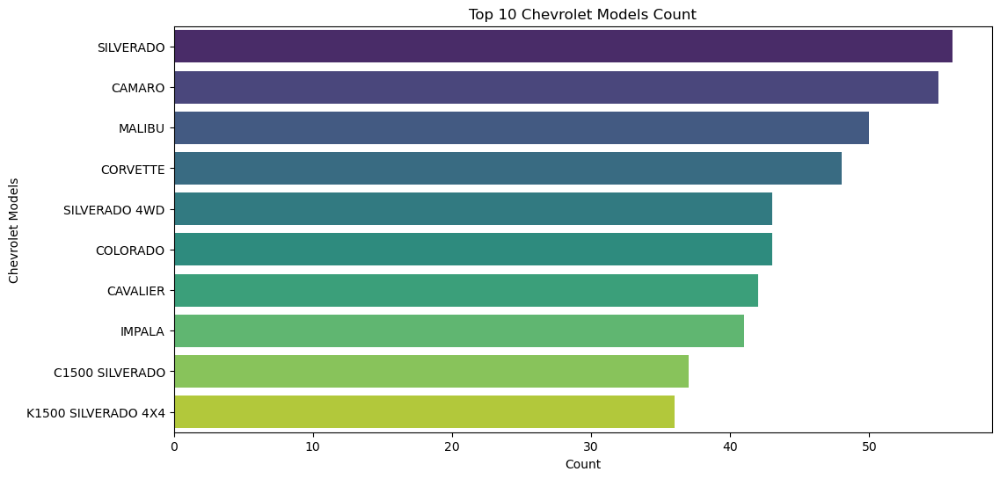

In [30]:
# Group by 'MODEL' and count occurrences
chevrolet_model_counts = chevrolet_df['MODEL'].value_counts().reset_index()

# Rename the columns for clarity
chevrolet_model_counts.columns = ['MODEL', 'COUNT']

# Display the top 10 models
top_10_chevrolet_models = chevrolet_model_counts.head(10)

# Plot the bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x='COUNT', y='MODEL', data=top_10_chevrolet_models, palette='viridis')
plt.title('Top 10 Chevrolet Models Count')
plt.xlabel('Count')
plt.ylabel('Chevrolet Models')
plt.show()

In [64]:
df['MODEL'].nunique()

4831

There are 4831 unique car models. When converting this categorical column to numerical, this will create a lot of columns. It is unlikely that a car model will be a feature that determines CO2 emissions. A car model is almost like a person's name - it does not provide much information or characteristics. A vehicle class, however, is a better indicator of the size of a car and might give a better prediction of fuel consumption and CO2 emissions. Thus, 'MODEL' will not be included in modelling to simplify the task.

In [31]:
fig = px.bar(top_10_chevrolet_models, x='COUNT', y='MODEL', orientation='h',
             title='Top 10 Chevrolet Models Count', labels={'COUNT': 'Count', 'MODEL': 'Chevrolet Models'})

# Customize the layout if needed
fig.update_layout(showlegend=False)

# Show the plot
fig.show()

Let's now look at the top 10 models with the highest counts (ie with the most options and car features)

In [32]:
# Count the occurrences of each car model
model_counts = df1['MODEL'].value_counts().reset_index()

# Rename the columns for clarity
model_counts.columns = ['MODEL', 'COUNT']

# Sort the DataFrame by counts in descending order
model_counts = model_counts.sort_values(by='COUNT', ascending=False)

# Select the top 10 models
top_10_models = model_counts.head(10)

# Create an interactive bar chart with Plotly Express
fig = px.bar(top_10_models, x='COUNT', y='MODEL', orientation='h',
             title='Top 10 Car Models Count', labels={'COUNT': 'Count', 'MODEL': 'Car Models'})

# Customize the layout if needed
fig.update_layout(showlegend=False)

# Show the plot
fig.show()

Let's also look at the vehicle classes with the most counts (the most available options in the Canadian market).

Now, let's look at the vehicle class and the total CO2 emissions. PICKUP TRUCK - STANDARD has the highest CO2 emissions. However, this relationship might not be true representation of the relationship between vehicle class and CO2 emissions as the number of cars of a vehicle class varies, so some vehicle class might be more represented than others. Hence, some form of normalization is needed to represent this relationship better. 

In [33]:
# Group by 'Vehicle Class' and calculate the sum of 'CO2 Emissions(g/km)'
df_v_class = df1.groupby('VEHICLE CLASS')['CO2 EMISSIONS (g/km)'].sum().reset_index()

# Sort the DataFrame by 'CO2 Emissions(g/km)' in descending order
df_v_class = df_v_class.sort_values(by='CO2 EMISSIONS (g/km)', ascending=False)

# Create the bar chart
fig = go.Figure(go.Bar(
    x=df_v_class['VEHICLE CLASS'],
    y=df_v_class['CO2 EMISSIONS (g/km)'],
    marker={'color': df_v_class['CO2 EMISSIONS (g/km)'], 'colorscale': 'Viridis'},
    text=df_v_class['CO2 EMISSIONS (g/km)'],
    textposition="outside",
))

# Update layout
fig.update_layout(
    title_text='CO2 vs Vehicle Class',
    xaxis_title="Vehicle Class",
    yaxis_title="Total CO2 Emissions",
    title_x=0.5
)

# Show the figure
fig.show()


Now, let's look at the count of vehicles and the respective number of cylinders and generate a bar plot. This will give us a breakdown of the cylinders of the vehicle models.

In [34]:
df1['CYLINDERS'].value_counts()

CYLINDERS
4     9705
6     9675
8     6166
5      591
12     506
3      194
10     180
2       17
16      15
Name: count, dtype: int64

In [35]:
cylinders_counts = df1['CYLINDERS'].value_counts()

# Create the bar chart with hovertext
fig = go.Figure(go.Bar(
    x=cylinders_counts.index,
    y=cylinders_counts.values,
    marker={'color': cylinders_counts.values, 'colorscale': 'Viridis'},
    text=cylinders_counts.values,
    hovertext=[f'Cylinders: {count}' for count in cylinders_counts.values],  # Hovertext
))

# Update layout
fig.update_layout(
    title_text='Cylinder Counts',
    xaxis_title="Cylinders",
    yaxis_title="Count",
    title_x=0.5
)

We can see from the above that most vehicle models have 4 and 6 cylinders, followed by 8 cylinders.

Let's generate a pairplot to explore the different relationships between numeric variables.

C:\Users\zaidj\Contacts\anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



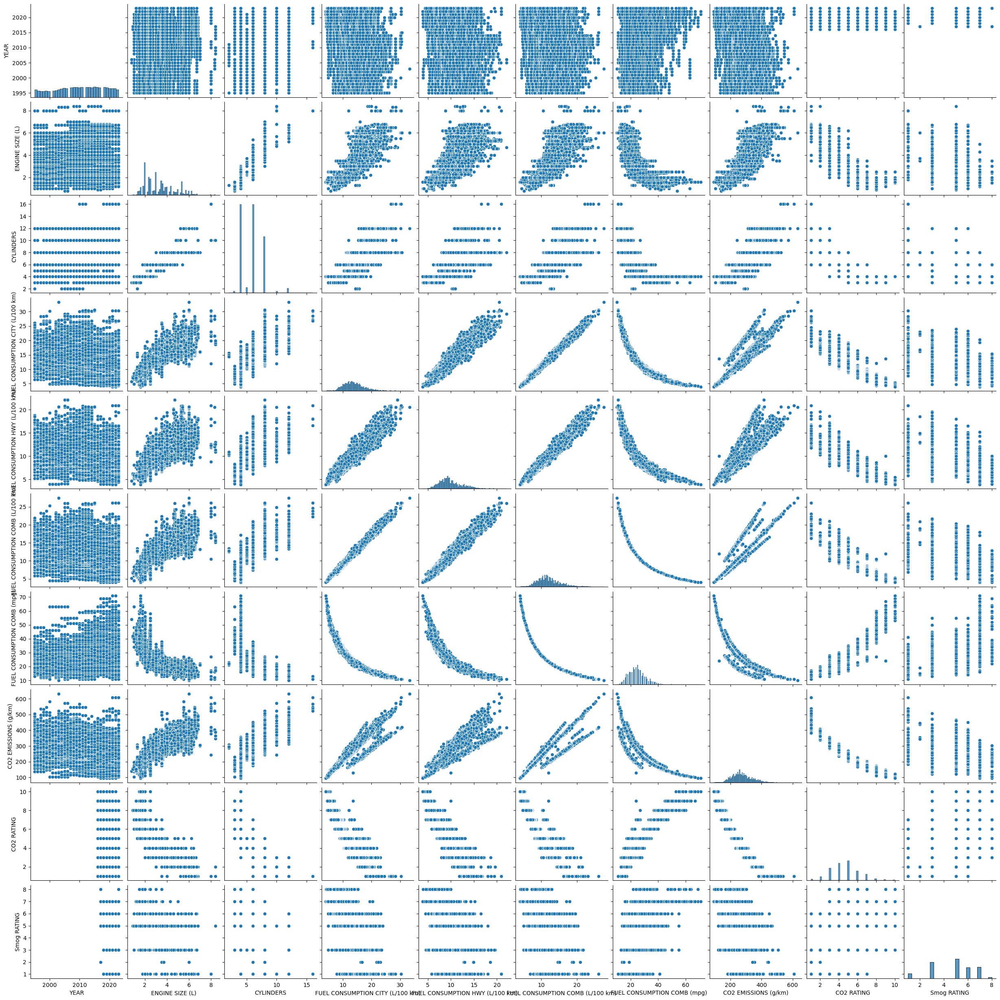

In [35]:
sns.pairplot(df1)
plt.show()

Later on, more EDA will be done to explore relationships between different car features and fuel consumption. After that, models will be applied to predict fuel consumption and CO2 emissions from car features.

In [36]:
df1['FUEL CONSUMPTION COMB (L/100 km)'].count()

27049

In [120]:
num_features = [feature for feature in df1.columns if df1[feature].dtype != 'O']
df1[num_features].head()

,YEAR,ENGINE SIZE (L),CYLINDERS,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
0,1995,1.8,4,11.6,8.3,10.1,28,232,NaN,NaN
1,1995,1.8,4,11.0,8.3,9.8,29,225,NaN,NaN
2,1995,1.8,4,10.8,8.3,9.7,29,223,NaN,NaN
3,1995,3.2,6,14.2,10.5,12.5,23,288,NaN,NaN
4,1995,3.2,6,14.6,11.0,13.0,22,299,NaN,NaN


In [121]:
discrete_features = [feature for feature in num_features if len(df1[feature].unique()) < 25]
print(discrete_features)
df1[discrete_features].head()

['CYLINDERS', 'CO2 RATING', 'Smog RATING']


,CYLINDERS,CO2 RATING,Smog RATING
0,4,NaN,NaN
1,4,NaN,NaN
2,4,NaN,NaN
3,6,NaN,NaN
4,6,NaN,NaN


In [39]:
continuous_features = [feature for feature in num_features if feature not in discrete_features]
print(continuous_features)

['YEAR', 'ENGINE SIZE (L)', 'FUEL CONSUMPTION CITY (L/100 km)', 'FUEL CONSUMPTION HWY (L/100 km)', 'FUEL CONSUMPTION COMB (L/100 km)', 'FUEL CONSUMPTION COMB (mpg)', 'CO2 EMISSIONS (g/km)']


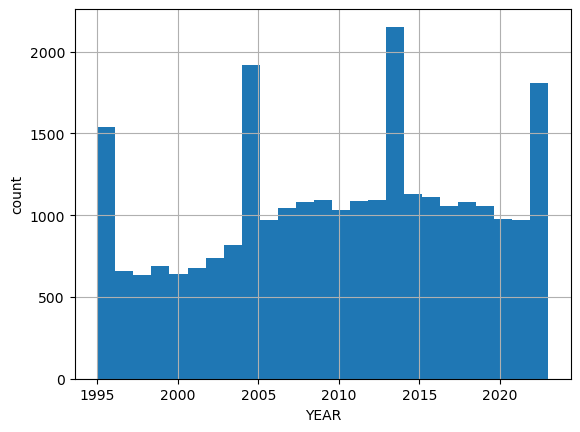

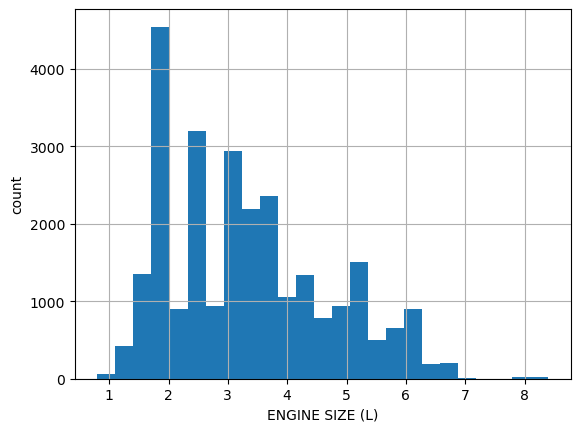

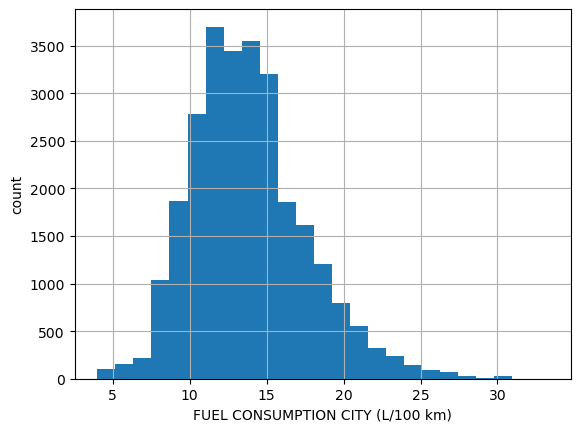

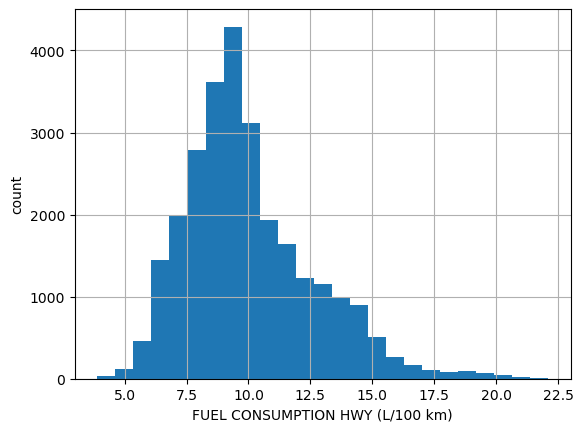

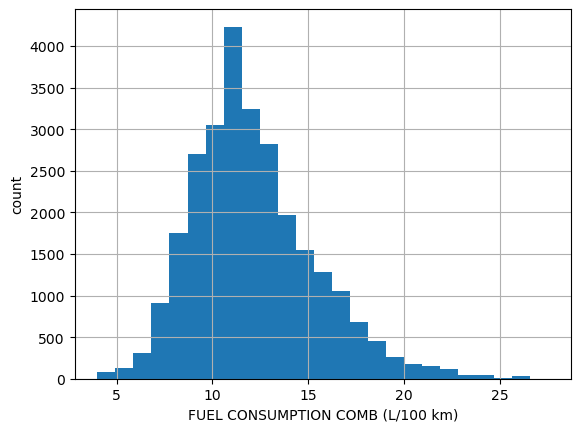

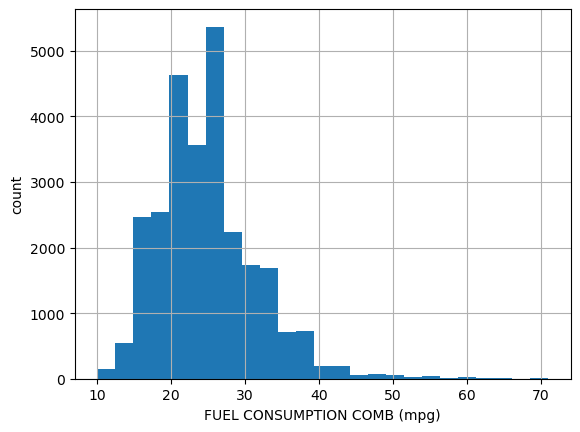

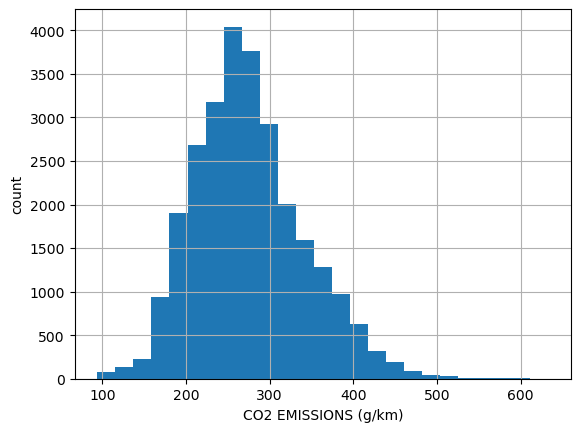

In [40]:
for feature in continuous_features:
    data = df1.copy()
    
    data[feature].hist(bins = 25)
    plt.xlabel(feature)
    plt.ylabel('count')
    plt.show()

As can be seen, CO2 emissions has a normal distribution. There is a slight right skew, but the distribution is overall normal. Hence, there is no need to do any log transformation. 


We can also see that fuel consumption and CO2 emissions follow a smilar trend. Let's See if fuel consumption (combined) in L/100 km and CO2 are directly correlated. To do that, I will use the 'corr' method.

In [41]:
correlation = df1['FUEL CONSUMPTION COMB (L/100 km)'].corr(df['CO2 EMISSIONS (g/km)'])
print(f"The correlation coefficient between FUEL CONSUMPTION COMB (L/100 km) and CO2 EMISSIONS (g/km) is: {correlation}")

The correlation coefficient between FUEL CONSUMPTION COMB (L/100 km) and CO2 EMISSIONS (g/km) is: 0.933562140525284


In [42]:
df1['TRANSMISSION'].unique()

array(['A4', 'M5', 'M6', 'A5', 'A3', 'M4', 'AS4', 'AS6', 'AS5', 'AV',
       'A6', 'AM6', 'A7', 'AM7', 'AS7', 'AS8', 'A8', 'M7', 'AV7', 'AV8',
       'AV6', 'AM5', 'A9', 'AS9', 'AM8', 'AM9', 'AS10', 'A10', 'AV10',
       'AV1'], dtype=object)

Now, let's explore the relationship between CO2 emissions and fuel type using a boxplot. It is difficult to draw conclusions merely by looking at the boxplot. The clear observation is that natural gas (N) has more CO2 emissions compared to the other fuel types. 

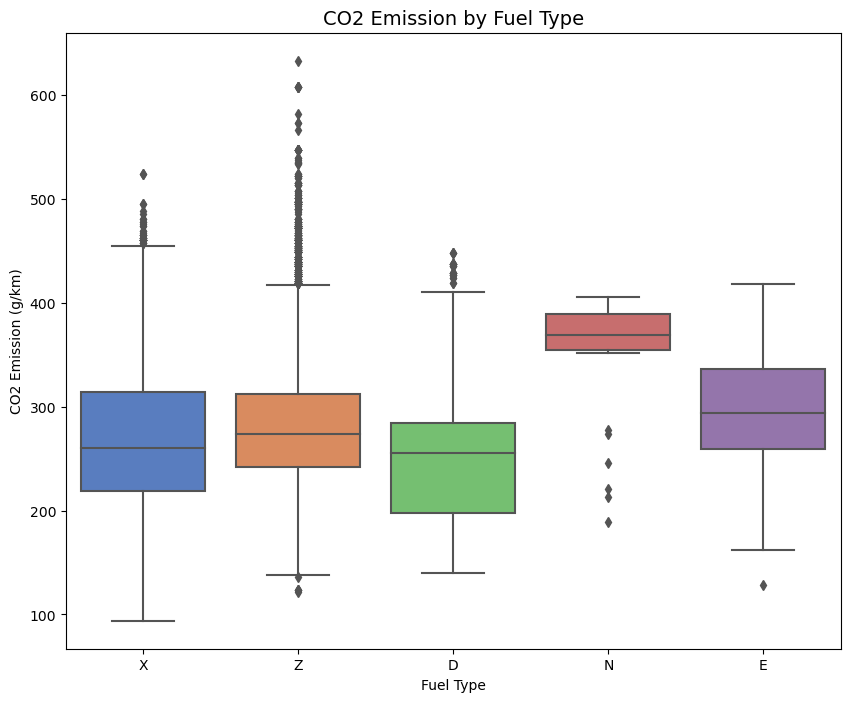

In [43]:
plt.figure(figsize = (10, 8))
sns.boxplot(x = "FUEL TYPE", y = "CO2 EMISSIONS (g/km)", data = df1, palette = "muted")

plt.title("CO2 Emission by Fuel Type", fontsize = 14)
plt.xlabel("Fuel Type")
plt.ylabel("CO2 Emission (g/km)")

plt.show()

In [76]:
# Calculate the median engine size
median_engine_size = np.median(df1['ENGINE SIZE (L)'])
# Print the result
print('The median engine size is: ', median_engine_size, 'liters')

The median engine size is:  3.0 liters


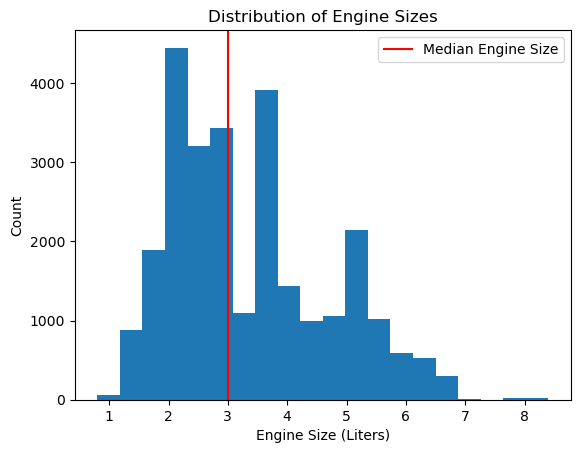

In [77]:
# Create a histogram of engine sizes to visualize the distribution
plt.hist(df1['ENGINE SIZE (L)'], bins=20)
plt.xlabel('Engine Size (Liters)')
plt.ylabel('Count')
plt.title('Distribution of Engine Sizes')
plt.axvline(x=median_engine_size, color='red', label='Median Engine Size')
plt.legend()
plt.show()

In [113]:
fig = px.histogram(df1, x="ENGINE SIZE (L)", marginal="rug", # can be `box`, `violin`
                         hover_data=df1.columns)
fig.show()

In [215]:
numeric_columns = df1.select_dtypes(include=['number'])
correlation_matrix = numeric_columns.corr()
correlation_matrix

,YEAR,ENGINE SIZE (L),CYLINDERS,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
YEAR,1.000000,-0.059182,-0.046139,-0.251560,-0.250818,-0.254324,0.273536,-0.275283,-0.128531,0.011944
ENGINE SIZE (L),-0.059182,1.000000,0.910229,0.819328,0.758675,0.806688,-0.754972,0.824545,-0.769523,-0.409495
CYLINDERS,-0.046139,0.910229,1.000000,0.786414,0.697716,0.763064,-0.711923,0.791058,-0.753907,-0.429515
FUEL CONSUMPTION CITY (L/100 km),-0.251560,0.819328,0.786414,1.000000,0.949791,0.993355,-0.926247,0.930649,-0.891665,-0.444952
FUEL CONSUMPTION HWY (L/100 km),-0.250818,0.758675,0.697716,0.949791,1.000000,0.979298,-0.889341,0.908661,-0.864584,-0.373353
FUEL CONSUMPTION COMB (L/100 km),-0.254324,0.806688,0.763064,0.993355,0.979298,1.000000,-0.923706,0.933562,-0.896446,-0.427227
FUEL CONSUMPTION COMB (mpg),0.273536,-0.754972,-0.711923,-0.926247,-0.889341,-0.923706,1.000000,-0.905308,0.928538,0.415347
CO2 EMISSIONS (g/km),-0.275283,0.824545,0.791058,0.930649,0.908661,0.933562,-0.905308,1.000000,-0.944629,-0.455100
CO2 RATING,-0.128531,-0.769523,-0.753907,-0.891665,-0.864584,-0.896446,0.928538,-0.944629,1.000000,0.451522
Smog RATING,0.011944,-0.409495,-0.429515,-0.444952,-0.373353,-0.427227,0.415347,-0.455100,0.451522,1.000000


In [216]:
# Create a mask for the upper triangle
mask = np.triu(np.ones_like(numeric_columns.corr(), dtype=bool), k=1)


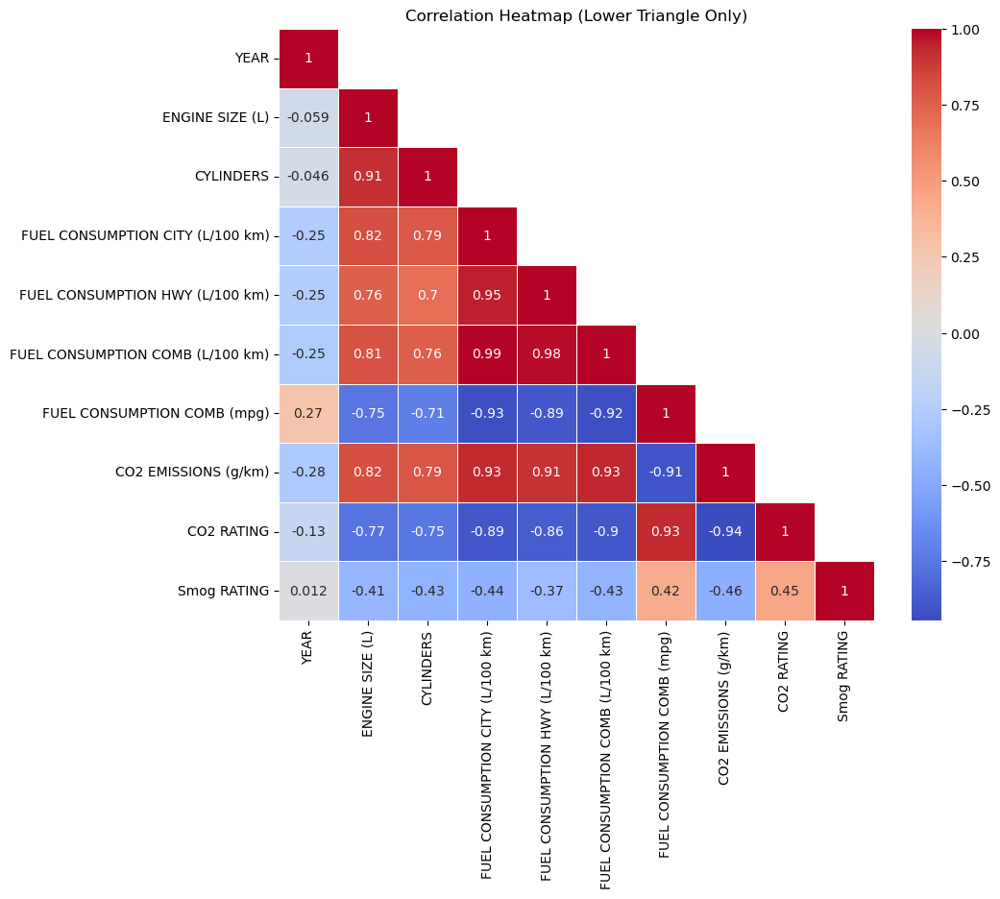

In [217]:
# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(numeric_columns.corr(), annot=True, cmap='coolwarm', linewidths=.5, mask=mask)
plt.title('Correlation Heatmap (Lower Triangle Only)')
plt.show()

We can see that most numeric variables are strongly positively correlated with CO2 emissions. Fuel consumption is miles per gallon (mpg) is inversely proportional to CO2 emissions, which makes sense the more mpg you get, the less fuel is consumed and less CO2 is generaged. 

We also see that the year of the car make is slightly inversely proportional, suggesting that newer cars emit less CO2, but the correlation coefficient is only -0.28. 

As stated earlier, CO2 rating and smog rating data is only available from 2016 and 2017 onwards, respectively. The heatmap does not include the missing values from previous year; `annot=True` ensures any missing values are not included.

CO2 rating and smog rating are derived from fuel consumption and CO2 emissions. As such they are not independent variables and are not features of a car. Hence, they can be dropped. 

Text(0, 0.5, 'CO2 Emissions(g/km)')

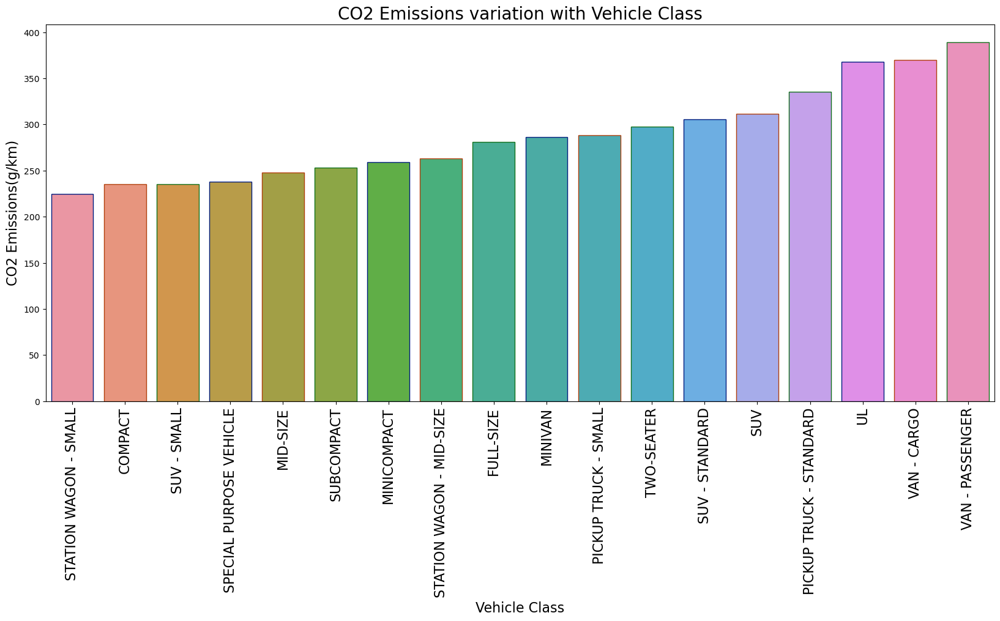

In [47]:
CO2_class = df1.groupby(['VEHICLE CLASS'])['CO2 EMISSIONS (g/km)'].mean().sort_values().reset_index()

plt.figure(figsize=(20,8))
sns.barplot(x = "VEHICLE CLASS",y="CO2 EMISSIONS (g/km)",data = CO2_class,
            edgecolor=sns.color_palette("dark", 3))
plt.title('CO2 Emissions variation with Vehicle Class', fontsize=20)
plt.xlabel('Vehicle Class', fontsize=16)
plt.xticks(rotation=90, horizontalalignment='center', fontsize=16)
plt.ylabel('CO2 Emissions(g/km)', fontsize=16)

In [48]:
small_suv_df = df1[df1['VEHICLE CLASS'] == 'SUV - SMALL']

In [49]:
small_suv_df

,YEAR,MAKE,MODEL,VEHICLE CLASS,ENGINE SIZE (L),CYLINDERS,TRANSMISSION,FUEL TYPE,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
15709,2013,ACURA,MDX AWD,SUV - SMALL,3.7,6,AS6,Z,14.8,11.3,13.2,21,304,NaN,NaN
15710,2013,ACURA,RDX AWD,SUV - SMALL,3.5,6,AS6,Z,12.1,8.7,10.6,27,244,NaN,NaN
15717,2013,ACURA,ZDX AWD,SUV - SMALL,3.7,6,AS6,Z,14.3,10.4,12.5,23,288,NaN,NaN
15741,2013,AUDI,Q5,SUV - SMALL,2.0,4,AS8,Z,11.9,8.6,10.4,27,239,NaN,NaN
15742,2013,AUDI,Q5 HYBRID,SUV - SMALL,2.0,4,AS8,Z,9.9,8.2,9.1,31,209,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27039,2023,VOLKSWAGEN,Tiguan R-Line 4MOTION,SUV - SMALL,2.0,4,AS8,X,11.0,8.3,9.8,29,229,5.0,7.0
27046,2023,VOLVO,XC40 B4 AWD,SUV - SMALL,2.0,4,AS8,Z,10.0,7.6,8.9,32,208,5.0,5.0
27047,2023,VOLVO,XC40 B5 AWD,SUV - SMALL,2.0,4,AS8,Z,10.2,7.9,9.2,31,215,5.0,5.0
27048,2023,VOLVO,XC60 B5 AWD,SUV - SMALL,2.0,4,AS8,Z,10.3,8.2,9.4,30,218,5.0,5.0


In [50]:
small_suv_models = small_suv_df['MODEL'].unique()

print("Car models in the SUV-Small class:")
print(small_suv_models)

Car models in the SUV-Small class:
['MDX AWD' 'RDX AWD' 'ZDX AWD' 'Q5' 'Q5 HYBRID' 'X1 xDRIVE28i'
 'X1 xDRIVE35i' 'X3 xDRIVE28i' 'X3 xDRIVE35i' 'ENCORE' 'ENCORE AWD'
 'EQUINOX' 'EQUINOX AWD' 'ORLANDO' 'TRAX' 'TRAX AWD' 'JOURNEY'
 'JOURNEY AWD' 'JOURNEY FFV' 'EDGE' 'EDGE AWD' 'ESCAPE' 'ESCAPE AWD'
 'TERRAIN' 'TERRAIN AWD' 'CROSSTOUR' 'CROSSTOUR AWD' 'CR-V' 'CR-V AWD'
 'PILOT' 'SANTA FE SPORT' 'SANTA FE SPORT 4WD' 'TUCSON' 'TUCSON 4WD'
 'FX37 AWD' 'FX50 AWD' 'JX35 AWD' 'COMPASS' 'COMPASS 4X4' 'PATRIOT'
 'PATRIOT 4X4' 'WRANGLER 4X4 (2-DOOR)' 'WRANGLER UNLIMITED 4X4 (4-DOOR)'
 'SORENTO' 'SORENTO 4WD' 'SPORTAGE' 'SPORTAGE 4WD' 'LR2'
 'RANGE ROVER EVOQUE' 'RANGE ROVER EVOQUE COUPE' 'RX 350 AWD'
 'RX 450h AWD' 'MKT AWD' 'MKX AWD' 'CX-5' 'CX-5 4WD' 'CX-9' 'CX-9 4WD'
 'GLK 350 4MATIC' 'OUTLANDER' 'OUTLANDER 4WD' 'RVR' 'RVR 4WD' 'MURANO AWD'
 'PATHFINDER' 'PATHFINDER 4WD' 'ROGUE' 'ROGUE AWD' 'XTERRA 4WD'
 'FORESTER AWD' 'OUTBACK AWD' 'TRIBECA AWD' 'XV CROSSTREK AWD'
 'GRAND VITARA URBAN/JX/JLX' 

In [51]:
model_counts = small_suv_df['MODEL'].value_counts()

print("Count of car models in the SUV-Small class:")
print(model_counts)

Count of car models in the SUV-Small class:
MODEL
PATRIOT                        21
COMPASS                        21
RVR 4WD                        18
CX-5                           17
Edge AWD                       17
                               ..
Santa Fe Sport Ultimate AWD     1
Sorento AWD FE                  1
CX-5                            1
Eclipse Cross                   1
XC40 B5 AWD                     1
Name: count, Length: 444, dtype: int64


In [52]:
unique_models_suv_small = small_suv_df['MODEL'].unique()

print("Unique car models in the SUV-Small class:")
print(unique_models_suv_small)

Unique car models in the SUV-Small class:
['MDX AWD' 'RDX AWD' 'ZDX AWD' 'Q5' 'Q5 HYBRID' 'X1 xDRIVE28i'
 'X1 xDRIVE35i' 'X3 xDRIVE28i' 'X3 xDRIVE35i' 'ENCORE' 'ENCORE AWD'
 'EQUINOX' 'EQUINOX AWD' 'ORLANDO' 'TRAX' 'TRAX AWD' 'JOURNEY'
 'JOURNEY AWD' 'JOURNEY FFV' 'EDGE' 'EDGE AWD' 'ESCAPE' 'ESCAPE AWD'
 'TERRAIN' 'TERRAIN AWD' 'CROSSTOUR' 'CROSSTOUR AWD' 'CR-V' 'CR-V AWD'
 'PILOT' 'SANTA FE SPORT' 'SANTA FE SPORT 4WD' 'TUCSON' 'TUCSON 4WD'
 'FX37 AWD' 'FX50 AWD' 'JX35 AWD' 'COMPASS' 'COMPASS 4X4' 'PATRIOT'
 'PATRIOT 4X4' 'WRANGLER 4X4 (2-DOOR)' 'WRANGLER UNLIMITED 4X4 (4-DOOR)'
 'SORENTO' 'SORENTO 4WD' 'SPORTAGE' 'SPORTAGE 4WD' 'LR2'
 'RANGE ROVER EVOQUE' 'RANGE ROVER EVOQUE COUPE' 'RX 350 AWD'
 'RX 450h AWD' 'MKT AWD' 'MKX AWD' 'CX-5' 'CX-5 4WD' 'CX-9' 'CX-9 4WD'
 'GLK 350 4MATIC' 'OUTLANDER' 'OUTLANDER 4WD' 'RVR' 'RVR 4WD' 'MURANO AWD'
 'PATHFINDER' 'PATHFINDER 4WD' 'ROGUE' 'ROGUE AWD' 'XTERRA 4WD'
 'FORESTER AWD' 'OUTBACK AWD' 'TRIBECA AWD' 'XV CROSSTREK AWD'
 'GRAND VITARA URBAN/J

In [53]:
# Filter rows where 'VEHICLE CLASS' is 'SUV-STANDARD'
standard_suv_df = df1[df1['VEHICLE CLASS'] == 'SUV - STANDARD']

# Get unique car models in the 'MODELS' column for 'SUV-STANDARD'
unique_models_suv_standard = standard_suv_df['MODEL'].unique()

print("Unique car models in the SUV-STANDARD class:")
print(unique_models_suv_standard)

Unique car models in the SUV-STANDARD class:
['Q7' 'Q7 TDI (modified)' 'X5 M' 'X5 xDRIVE35d' 'X5 xDRIVE35i'
 'X5 xDRIVE50i' 'X6 M' 'X6 xDRIVE35i' 'X6 xDRIVE50i' 'ENCLAVE'
 'ENCLAVE AWD' 'ESCALADE AWD' 'ESCALADE ESV AWD' 'ESCALADE HYBRID 4WD'
 'SRX' 'SRX AWD' 'SUBURBAN' 'SUBURBAN 4WD' 'SUBURBAN 4WD HD' 'SUBURBAN HD'
 'TAHOE' 'TAHOE 4WD' 'TAHOE HYBRID' 'TAHOE HYBRID 4WD' 'TRAVERSE'
 'TRAVERSE AWD' 'DURANGO AWD (FuelSaver MDS)' 'DURANGO AWD FFV'
 'EXPEDITION 4X4 FFV' 'EXPLORER' 'EXPLORER FFV' 'EXPLORER FFV AWD' 'FLEX'
 'FLEX AWD NA' 'FLEX AWD TC' 'ACADIA' 'ACADIA AWD' 'YUKON' 'YUKON 4WD'
 'YUKON DENALI AWD' 'YUKON DENALI HYBRID 4WD' 'YUKON DENALI XL AWD'
 'YUKON HYBRID' 'YUKON HYBRID 4WD' 'YUKON XL' 'YUKON XL 4WD'
 'YUKON XL 4WD HD' 'YUKON XL HD' 'PILOT AWD' 'QX56 4WD'
 'GRAND CHEROKEE 4X4 (FuelSaver MDS)' 'GRAND CHEROKEE 4X4 FFV'
 'GRAND CHEROKEE 4X4 SRT (FuelSaver MDS)' 'LR4' 'RANGE ROVER'
 'RANGE ROVER SPORT' 'RANGE ROVER SPORT SC' 'RANGE ROVER SUPERCHARGED'
 'GX 460' 'LX 570' 'NAVIGAT

In [54]:
# Count occurrences of each car model in 'MODELS'
model_counts_suv_standard = standard_suv_df['MODEL'].value_counts()

print("Count of car models in the SUV-Small class:")
print(model_counts_suv_standard)

Count of car models in the SUV-Small class:
MODEL
Yukon XL 4WD          15
Yukon 4WD             15
Explorer AWD          15
Tahoe 4WD             15
Suburban 4WD          14
                      ..
Aviator                1
AMG GLE 53 4MATIC+     1
GLE 350 4MATIC         1
GLE 450 4MATIC         1
XC90 B6 AWD            1
Name: count, Length: 389, dtype: int64


In [55]:
# Filter rows where 'VEHICLE CLASS' is 'SUV'
suv_df = df1[df1['VEHICLE CLASS'] == 'SUV']

# Count occurrences of each car model in 'MODELS'
model_counts_suv = suv_df['MODEL'].value_counts()

print("Count of car models in the SUV class:")
print(model_counts_suv)

Count of car models in the SUV class:
MODEL
TJ 4X4                   37
4RUNNER 4X4              32
EXPLORER 4X4             31
GRAND CHEROKEE 4X4       29
SANTA FE                 29
                         ..
B9 TRIBECA                1
HIGHLANDER HYBRID AWD     1
X6 XDRIVE 35i             1
YUKON 4X4 HYBRID          1
XC70 3.2                  1
Name: count, Length: 603, dtype: int64


In [56]:
unique_models_suv = suv_df['MODEL'].unique()

print("Unique car models in the SUV-STANDARD class:")
print(unique_models_suv)

Unique car models in the SUV-STANDARD class:
['C1500 SUBURBAN' 'K1500 SUBURBAN 4X4' 'K1500 TAHOE 4X4'
 'K1500 TAHOE 4X4 TURBODIESEL' 'K1500 YUKON 4X4 TURBODIESEL'
 'S10 BLAZER #' 'S10 BLAZER 4X4 #' 'TRACKER CONVERTIBLE'
 'TRACKER CONVERTIBLE 4X4' 'TRACKER VAN 4X4' 'BRONCO 4X4'
 'K1500 YUKON 4X4' 'S15 JIMMY #' 'S15 JIMMY 4X4 #' 'RODEO 4X4'
 'TROOPER 4X4' 'TROOPER 4X4 #' 'CHEROKEE' 'CHEROKEE 4X4' 'GRAND CHEROKEE'
 'GRAND CHEROKEE 4X4' 'YJ 4X4' 'DISCOVERY 4X4'
 'RANGE ROVER COUNTY LWB 4X4' 'PATHFINDER 4X4' 'SUNRUNNER CONVERTIBLE'
 'SUNRUNNER CONVERTIBLE 4X4' 'SUNRUNNER VAN 4X4' 'JUSTY 4X4'
 'SIDEKICK 4-DOOR 4X4' 'SIDEKICK 4X4' 'SIDEKICK JA' '4-RUNNER 4X4'
 'C1500 TAHOE' 'S10 BLAZER' 'S10 BLAZER 4X4' 'S10 BLAZER AWD' 'EXPLORER'
 'EXPLORER 4X4' 'C1500 YUKON' 'S15 JIMMY' 'S15 JIMMY 4X4' 'S15 JIMMY AWD'
 'RANGE ROVER 4.0 4X4' 'RANGE ROVER 4.6 4X4' 'SIDEKICK 2-DOOR'
 'SIDEKICK 4-DOOR' 'SIDEKICK SPORT' '4RUNNER 4X4'
 'K1500 TAHOE 4X4 TURBO DIESEL' 'JEEP TJ 4X4' 'EXPEDITION'
 'EXPEDITION 4X4' 'K

In [107]:
grouped_df

,BASE_NAME,CO2 EMISSIONS (g/km)
0,4,361.000000
1,4RUNNER,326.153846
2,9,354.727273
3,ACADIA,289.666667
4,ACCORD,260.800000
...,...,...
148,XL7,299.000000
149,XTERRA,337.878788
150,YJ,348.500000
151,YUKON,324.054945


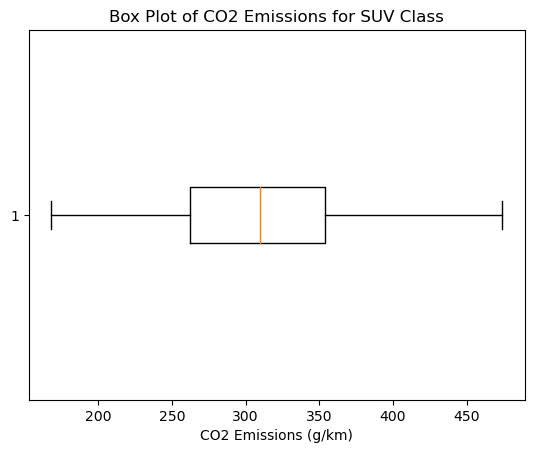

In [58]:
plt.boxplot(suv_df['CO2 EMISSIONS (g/km)'], vert=False)
plt.xlabel('CO2 Emissions (g/km)')
plt.title('Box Plot of CO2 Emissions for SUV Class')
plt.show()

In [118]:
# Create a box plot with Plotly
fig = px.box(suv_df, x='CO2 EMISSIONS (g/km)', orientation='h', labels={'CO2 EMISSIONS (g/km)': 'CO2 Emissions (g/km)'},
             title='Box Plot of CO2 Emissions for SUV Class')
fig.show()

NameError: name 'suv_df' is not defined

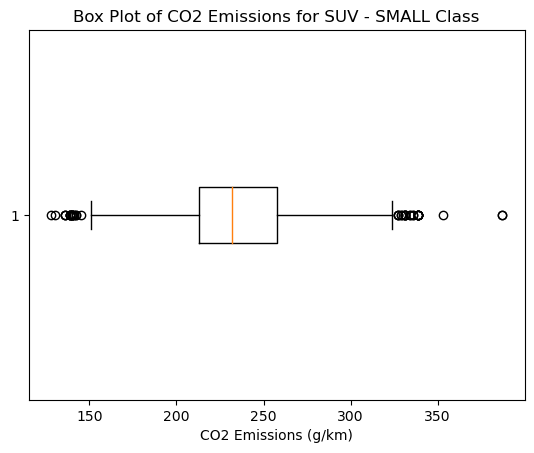

In [60]:
# Filter rows where 'VEHICLE CLASS' is 'SUV - SMALL'
suv_small_df = df1[df1['VEHICLE CLASS'] == 'SUV - SMALL']

# Create a box plot
plt.boxplot(suv_small_df['CO2 EMISSIONS (g/km)'], vert=False)
plt.xlabel('CO2 Emissions (g/km)')
plt.title('Box Plot of CO2 Emissions for SUV - SMALL Class')
plt.show()

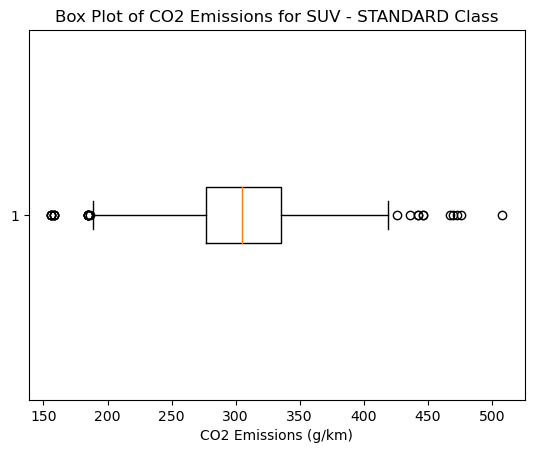

In [62]:
# Filter rows where 'VEHICLE CLASS' is 'SUV - SMALL'
suv_standard_df = df1[df1['VEHICLE CLASS'] == 'SUV - STANDARD']

# Create a box plot
plt.boxplot(suv_standard_df['CO2 EMISSIONS (g/km)'], vert=False)
plt.xlabel('CO2 Emissions (g/km)')
plt.title('Box Plot of CO2 Emissions for SUV - STANDARD Class')
plt.show()

In [116]:
# Create side-by-side box plots with Plotly
fig = px.box(df1, x='VEHICLE CLASS', y='CO2 EMISSIONS (g/km)', category_orders={'VEHICLE CLASS': ['SUV', 'SUV - SMALL', 'SUV - STANDARD']},
             title='Box Plots of CO2 Emissions for SUV Classes')
fig.show()

In [131]:
# Filter rows for 'SUV', 'SUV - SMALL', and 'SUV - STANDARD'
filtered_df = df1[df1['VEHICLE CLASS'].isin(['SUV', 'SUV - SMALL', 'SUV - STANDARD'])]

# Create a grouped box plot with Plotly
fig = px.box(filtered_df, x='VEHICLE CLASS', y='CO2 EMISSIONS (g/km)',
             title='Grouped Box Plot of CO2 Emissions for SUV Classes')
fig.show()

From the box plot, we can see that the median for SUV and SUV - STANDARD are similar, with SUV having bigger IQR.

In [132]:
# Calculate the mean for each class
mean_values = filtered_df.groupby('VEHICLE CLASS')['CO2 EMISSIONS (g/km)'].mean().reset_index()

# Create a bar plot with Plotly
fig = px.bar(mean_values, x='VEHICLE CLASS', y='CO2 EMISSIONS (g/km)',
             title='Mean CO2 Emissions for SUV Classes')
fig.show()

In [133]:
from scipy.stats import f_oneway

# Extract data for each class
suv_data = df1[df1['VEHICLE CLASS'] == 'SUV']['CO2 EMISSIONS (g/km)']
suv_small_data = df1[df1['VEHICLE CLASS'] == 'SUV - SMALL']['CO2 EMISSIONS (g/km)']
suv_standard_data = df1[df1['VEHICLE CLASS'] == 'SUV - STANDARD']['CO2 EMISSIONS (g/km)']


# Perform ANOVA test
f_statistic, p_value = f_oneway(suv_data, suv_small_data, suv_standard_data)

# Print the results
print(f'F-statistic: {f_statistic}')
print(f'P-value: {p_value}')

# Interpret the results
alpha = 0.05
if p_value < alpha:
    print('Reject the null hypothesis: There are significant differences between the means.')
else:
    print('Fail to reject the null hypothesis: There are no significant differences between the means.')

F-statistic: 1528.4497367459626
P-value: 0.0
Reject the null hypothesis: There are significant differences between the means.


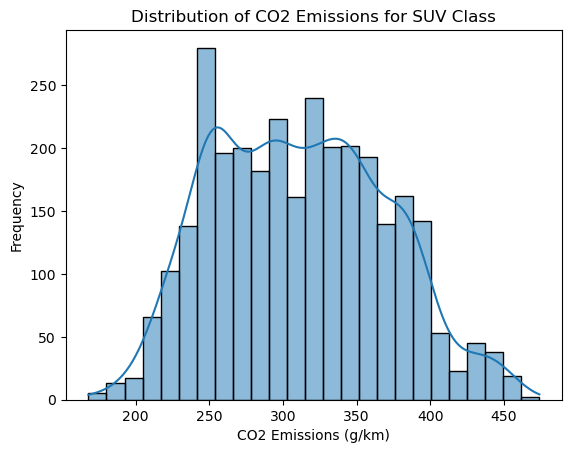

In [134]:
# Filter rows for 'SUV' class
suv_data = df1[df1['VEHICLE CLASS'] == 'SUV']['CO2 EMISSIONS (g/km)']

# Create a distribution plot with seaborn
sns.histplot(suv_data, kde=True)
plt.xlabel('CO2 Emissions (g/km)')
plt.ylabel('Frequency')
plt.title('Distribution of CO2 Emissions for SUV Class')
plt.show()

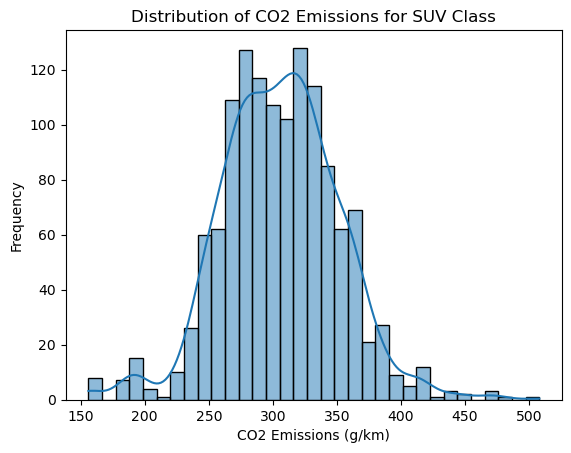

In [69]:
# Filter rows for 'SUV' class
suv_standard_data = df1[df1['VEHICLE CLASS'] == 'SUV - STANDARD']['CO2 EMISSIONS (g/km)']

# Create a distribution plot with seaborn
sns.histplot(suv_standard_data, kde=True)
plt.xlabel('CO2 Emissions (g/km)')
plt.ylabel('Frequency')
plt.title('Distribution of CO2 Emissions for SUV Class')
plt.show()

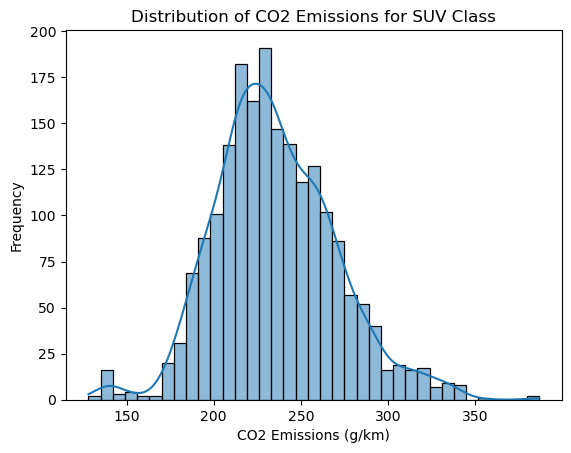

In [70]:
# Filter rows for 'SUV' class
suv_small_data = df1[df1['VEHICLE CLASS'] == 'SUV - SMALL']['CO2 EMISSIONS (g/km)']

# Create a distribution plot with seaborn
sns.histplot(suv_small_data, kde=True)
plt.xlabel('CO2 Emissions (g/km)')
plt.ylabel('Frequency')
plt.title('Distribution of CO2 Emissions for SUV Class')
plt.show()

In [71]:
import pandas as pd
from scipy.stats import kruskal

In [72]:
# Perform Kruskal-Wallis test
h_statistic, p_value = kruskal(suv_data, suv_small_data, suv_standard_data)

# Print the results
print(f'H-statistic: {h_statistic}')
print(f'P-value: {p_value}')

# Interpret the results
alpha = 0.05
if p_value < alpha:
    print('Reject the null hypothesis: There are significant differences between the medians.')
else:
    print('Fail to reject the null hypothesis: There are no significant differences between the medians.')


H-statistic: 2278.902450964895
P-value: 0.0
Reject the null hypothesis: There are significant differences between the medians.


In [204]:
cars_df = df1.copy()

In [205]:
cars_df.head()

,YEAR,MAKE,MODEL,VEHICLE CLASS,ENGINE SIZE (L),CYLINDERS,TRANSMISSION,FUEL TYPE,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
0,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,A4,X,11.6,8.3,10.1,28,232,NaN,NaN
1,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,M5,X,11.0,8.3,9.8,29,225,NaN,NaN
2,1995,ACURA,INTEGRA GS-R,SUBCOMPACT,1.8,4,M5,Z,10.8,8.3,9.7,29,223,NaN,NaN
3,1995,ACURA,LEGEND,COMPACT,3.2,6,A4,Z,14.2,10.5,12.5,23,288,NaN,NaN
4,1995,ACURA,LEGEND COUPE,COMPACT,3.2,6,A4,Z,14.6,11.0,13.0,22,299,NaN,NaN


Let's rename column names as there are many gaps, which creates unnecessary errors.

In [208]:
renamed_col = {
    'VEHICLE CLASS': 'vehicle_class',
    'ENGINE SIZE (L)': 'engine_size',
    'FUEL TYPE': 'fuel_type',
    'FUEL CONSUMPTION CITY (L/100 km)': 'fuel_cons_city',
    'FUEL CONSUMPTION HWY (L/100 km)': 'fuel_cons_hwy',
    'FUEL CONSUMPTION COMB (L/100 km)': 'fuel_cons_comb',
    'FUEL CONSUMPTION COMB (mpg)': 'fuel_cons_comb_mpg',
    'CO2 EMISSIONS (g/km)': 'co2',
    'CO2 RATING': 'co2_rating',
    'Smog RATING': 'smog_rating'
}
cars_df.rename(renamed_col, axis='columns', inplace=True)

In [209]:
cars_df.keys()

Index(['YEAR', 'MAKE', 'MODEL', 'vehicle_class', 'engine_size', 'CYLINDERS',
       'TRANSMISSION', 'fuel_type', 'fuel_cons_city', 'fuel_cons_hwy',
       'fuel_cons_comb', 'fuel_cons_comb_mpg', 'co2', 'co2_rating',
       'smog_rating'],
      dtype='object')

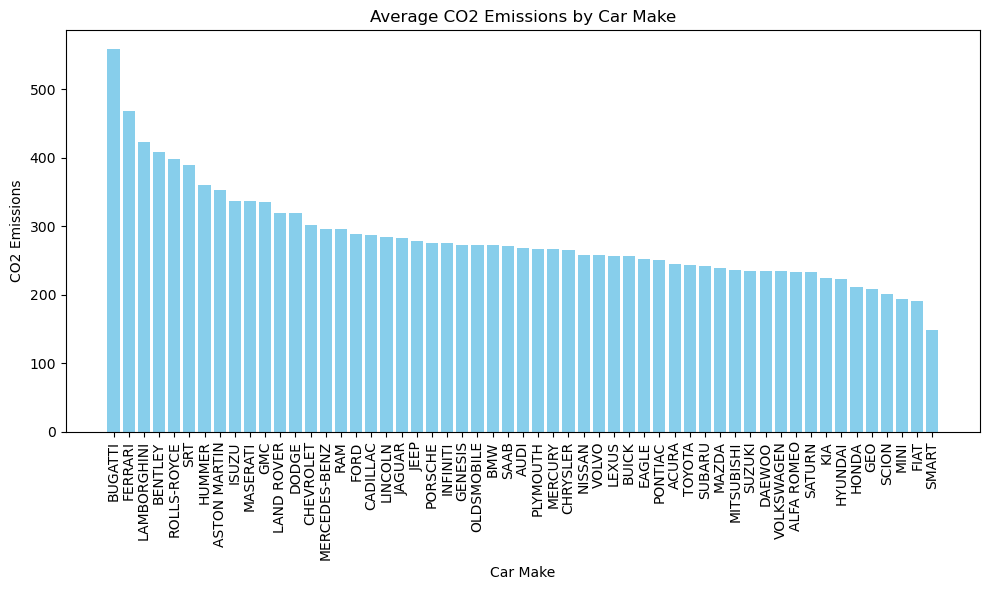

In [210]:
# Assuming 'MAKE' is a column representing car makes and 'co2' is a column representing CO2 emissions
# Replace 'MAKE' and 'co2' with your actual column names
make_co2_data = cars_df.groupby('MAKE')['co2'].mean().reset_index()

# Sorting the data based on CO2 emissions for better visualization
make_co2_data = make_co2_data.sort_values(by='co2', ascending=False)

# Creating a bar plot
plt.figure(figsize=(10, 6))
plt.bar(make_co2_data['MAKE'], make_co2_data['co2'], color='skyblue')
plt.xlabel('Car Make')
plt.ylabel('CO2 Emissions')
plt.title('Average CO2 Emissions by Car Make')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.tight_layout()

# Display the plot
plt.show()

In [211]:
mean_co2_by_make = cars_df.groupby('MAKE')['co2'].mean().reset_index()

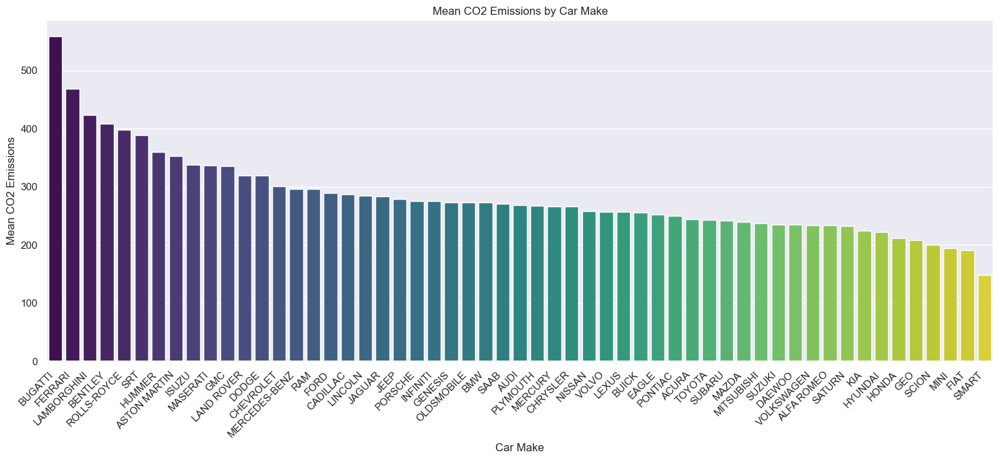

In [95]:
# Sorting the data based on mean CO2 emissions for better visualization
mean_co2_by_make = mean_co2_by_make.sort_values(by='co2', ascending=False)

# Creating a bar plot
plt.figure(figsize=(15, 7))
sns.set_theme(style="darkgrid")
sns.barplot(x='MAKE', y='co2', data=mean_co2_by_make, palette='viridis')
plt.title('Mean CO2 Emissions by Car Make')
plt.xlabel('Car Make')
plt.ylabel('Mean CO2 Emissions')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()

# Display the plot
plt.show()

Based on the above, we can see that luxury racing cars have the highest CO2 emissions, led by Bugatti, Ferrari, and Lamborghini. Also, Smart car has the lowest CO2 emissions.  

see relationship between engine size and CO2\

search the most selling car make in Canada and explore that further (over the years, how has technology evolved?)

Let's now explore the relationship between engine size and CO2 emissions with a scatter plot. 

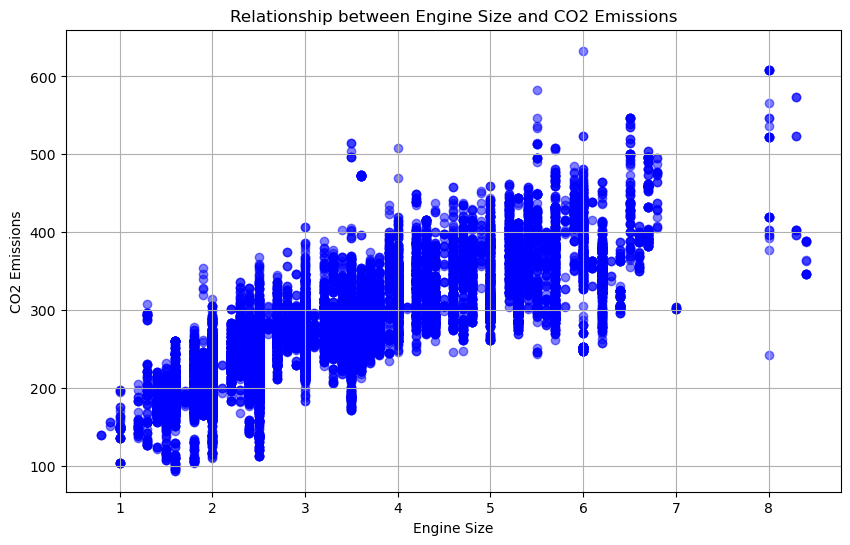

In [212]:
plt.figure(figsize=(10, 6))
plt.scatter(cars_df['engine_size'], cars_df['co2'], alpha=0.5, color='blue')
plt.title('Relationship between Engine Size and CO2 Emissions')
plt.xlabel('Engine Size')
plt.ylabel('CO2 Emissions')
plt.grid(True)
plt.show()

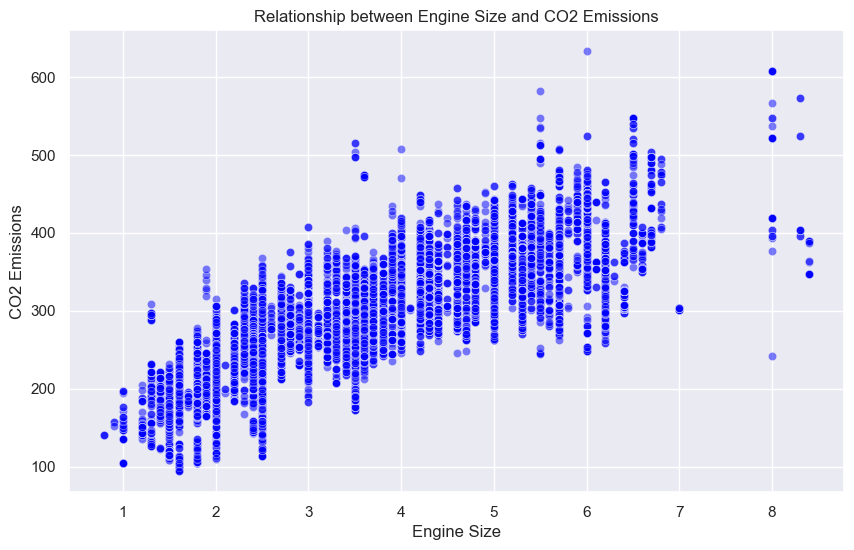

In [97]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='engine_size', y='co2', data=cars_df, alpha=0.5, color='blue')
plt.title('Relationship between Engine Size and CO2 Emissions')
plt.xlabel('Engine Size')
plt.ylabel('CO2 Emissions')
plt.grid(True)
plt.show()

Let's also calculate the correlation coefficient.

In [98]:
correlation_coefficient = cars_df['engine_size'].corr(cars_df['co2'])

print(f"Correlation coefficient between engine_size and CO2 emissions: {correlation_coefficient:.2f}")

Correlation coefficient between engine_size and CO2 emissions: 0.82


We can see that there is a linear trend in the scatter plot: As engine size increases, CO2 emissions increase.

Further, the correlation coefficient of 0.82 is high (close to 1), suggesting a positive correlation. 

Hence, engine size is a factor in determining CO2 emissions of a car. 

Let's now look at the distribution of transmission. For that

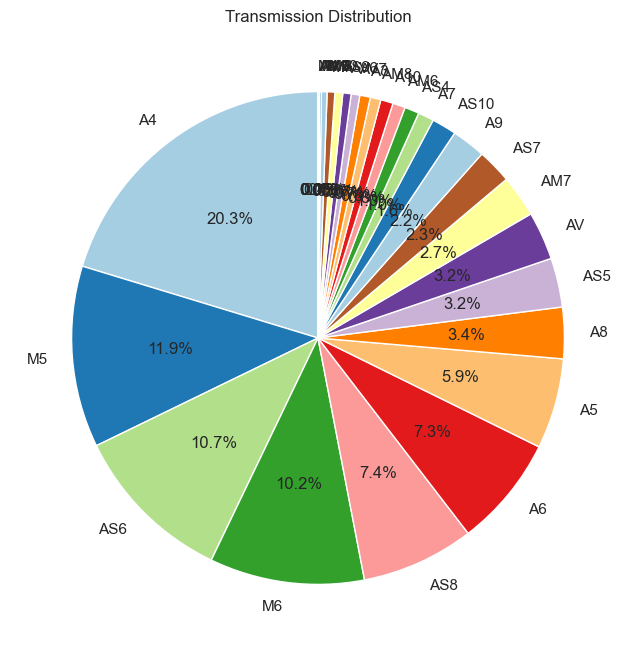

In [101]:
transmission_distribution = cars_df['TRANSMISSION'].value_counts()

# Plotting a pie chart
plt.figure(figsize=(8, 8))
plt.pie(transmission_distribution, labels=transmission_distribution.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
plt.title('Transmission Distribution')
plt.show()

In [51]:
numeric_cols = cars_df.select_dtypes(include=['number'])

In [52]:
numeric_cols

,YEAR,ENGINE SIZE (L),CYLINDERS,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
0,1995,1.8,4,11.6,8.3,10.1,28,232,NaN,NaN
1,1995,1.8,4,11.0,8.3,9.8,29,225,NaN,NaN
2,1995,1.8,4,10.8,8.3,9.7,29,223,NaN,NaN
3,1995,3.2,6,14.2,10.5,12.5,23,288,NaN,NaN
4,1995,3.2,6,14.6,11.0,13.0,22,299,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
27047,2023,2.0,4,10.2,7.9,9.2,31,215,5.0,5.0
27048,2023,2.0,4,10.3,8.2,9.4,30,218,5.0,5.0
27049,2023,2.0,4,11.1,8.7,10.0,28,233,5.0,7.0
27050,2023,2.0,4,10.5,8.4,9.6,29,223,5.0,5.0


To do regression, we first have to convert any non-numeric columns to numeric columns. We can achieve this with one-hot encoder where we convert categorical columns using dummy variables that is available in pandas library. We will set `drop_first=True` to avoid multicollinearity by removing the first category.

In [53]:
cars_df.head()

,YEAR,MAKE,MODEL,VEHICLE CLASS,ENGINE SIZE (L),CYLINDERS,TRANSMISSION,FUEL TYPE,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
0,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,A4,X,11.6,8.3,10.1,28,232,NaN,NaN
1,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,M5,X,11.0,8.3,9.8,29,225,NaN,NaN
2,1995,ACURA,INTEGRA GS-R,SUBCOMPACT,1.8,4,M5,Z,10.8,8.3,9.7,29,223,NaN,NaN
3,1995,ACURA,LEGEND,COMPACT,3.2,6,A4,Z,14.2,10.5,12.5,23,288,NaN,NaN
4,1995,ACURA,LEGEND COUPE,COMPACT,3.2,6,A4,Z,14.6,11.0,13.0,22,299,NaN,NaN


In [58]:
cars_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27049 entries, 0 to 27051
Data columns (total 15 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   YEAR                              27049 non-null  int64  
 1   MAKE                              27049 non-null  object 
 2   MODEL                             27049 non-null  object 
 3   VEHICLE CLASS                     27049 non-null  object 
 4   ENGINE SIZE (L)                   27049 non-null  float64
 5   CYLINDERS                         27049 non-null  int64  
 6   TRANSMISSION                      27049 non-null  object 
 7   FUEL TYPE                         27049 non-null  object 
 8   FUEL CONSUMPTION CITY (L/100 km)  27049 non-null  float64
 9   FUEL CONSUMPTION HWY (L/100 km)   27049 non-null  float64
 10  FUEL CONSUMPTION COMB (L/100 km)  27049 non-null  float64
 11  FUEL CONSUMPTION COMB (mpg)       27049 non-null  int64  
 12  CO2 EMISS

numeric_columns = df1.select_dtypes(include=['number'])
correlation_matrix = numeric_columns.corr()
correlation_matrix

In [166]:
cars_df3 = df1.copy()

In [167]:
cars_df3.head()

,YEAR,MAKE,MODEL,VEHICLE CLASS,ENGINE SIZE (L),CYLINDERS,TRANSMISSION,FUEL TYPE,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,Smog RATING
0,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,A4,X,11.6,8.3,10.1,28,232,NaN,NaN
1,1995,ACURA,INTEGRA,SUBCOMPACT,1.8,4,M5,X,11.0,8.3,9.8,29,225,NaN,NaN
2,1995,ACURA,INTEGRA GS-R,SUBCOMPACT,1.8,4,M5,Z,10.8,8.3,9.7,29,223,NaN,NaN
3,1995,ACURA,LEGEND,COMPACT,3.2,6,A4,Z,14.2,10.5,12.5,23,288,NaN,NaN
4,1995,ACURA,LEGEND COUPE,COMPACT,3.2,6,A4,Z,14.6,11.0,13.0,22,299,NaN,NaN


In [168]:
cars_df3.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27049 entries, 0 to 27051
Data columns (total 15 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   YEAR                              27049 non-null  int64  
 1   MAKE                              27049 non-null  object 
 2   MODEL                             27049 non-null  object 
 3   VEHICLE CLASS                     27049 non-null  object 
 4   ENGINE SIZE (L)                   27049 non-null  float64
 5   CYLINDERS                         27049 non-null  int64  
 6   TRANSMISSION                      27049 non-null  object 
 7   FUEL TYPE                         27049 non-null  object 
 8   FUEL CONSUMPTION CITY (L/100 km)  27049 non-null  float64
 9   FUEL CONSUMPTION HWY (L/100 km)   27049 non-null  float64
 10  FUEL CONSUMPTION COMB (L/100 km)  27049 non-null  float64
 11  FUEL CONSUMPTION COMB (mpg)       27049 non-null  int64  
 12  CO2 EMISS

In [169]:
cars_df3['TRANSMISSION'].nunique()

30

In [170]:
columns_to_encode = ['MAKE', 'VEHICLE CLASS', 'TRANSMISSION', 'FUEL TYPE']

In [171]:
# Apply one-hot encoding to the specified columns
df_encoded = pd.get_dummies(cars_df3, columns=columns_to_encode, drop_first=True)

In [172]:
df_encoded.head()

,YEAR,MODEL,ENGINE SIZE (L),CYLINDERS,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),CO2 RATING,...,TRANSMISSION_AV7,TRANSMISSION_AV8,TRANSMISSION_M4,TRANSMISSION_M5,TRANSMISSION_M6,TRANSMISSION_M7,FUEL TYPE_E,FUEL TYPE_N,FUEL TYPE_X,FUEL TYPE_Z
0,1995,INTEGRA,1.8,4,11.6,8.3,10.1,28,232,NaN,...,False,False,False,False,False,False,False,False,True,False
1,1995,INTEGRA,1.8,4,11.0,8.3,9.8,29,225,NaN,...,False,False,False,True,False,False,False,False,True,False
2,1995,INTEGRA GS-R,1.8,4,10.8,8.3,9.7,29,223,NaN,...,False,False,False,True,False,False,False,False,False,True
3,1995,LEGEND,3.2,6,14.2,10.5,12.5,23,288,NaN,...,False,False,False,False,False,False,False,False,False,True
4,1995,LEGEND COUPE,3.2,6,14.6,11.0,13.0,22,299,NaN,...,False,False,False,False,False,False,False,False,False,True


In [173]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27049 entries, 0 to 27051
Columns: 115 entries, YEAR to FUEL TYPE_Z
dtypes: bool(104), float64(6), int64(4), object(1)
memory usage: 5.2+ MB


In [174]:
df_encoded.shape

(27049, 115)

Now, let's drop the columns we will not be using in modeling.

In [175]:
columns_to_drop = ['MODEL', 'CO2 RATING', 'Smog RATING']

In [177]:
# Drop the specified columns
df_encoded = df_encoded.drop(columns=columns_to_drop)

In [178]:
df_encoded.shape

(27049, 112)

In [179]:
print(df_encoded.columns)

Index(['YEAR', 'ENGINE SIZE (L)', 'CYLINDERS',
       'FUEL CONSUMPTION CITY (L/100 km)', 'FUEL CONSUMPTION HWY (L/100 km)',
       'FUEL CONSUMPTION COMB (L/100 km)', 'FUEL CONSUMPTION COMB (mpg)',
       'CO2 EMISSIONS (g/km)', 'MAKE_ALFA ROMEO', 'MAKE_ASTON MARTIN',
       ...
       'TRANSMISSION_AV7', 'TRANSMISSION_AV8', 'TRANSMISSION_M4',
       'TRANSMISSION_M5', 'TRANSMISSION_M6', 'TRANSMISSION_M7', 'FUEL TYPE_E',
       'FUEL TYPE_N', 'FUEL TYPE_X', 'FUEL TYPE_Z'],
      dtype='object', length=112)


We see above that get_dummies converted categorical columns to boolean. Let's make sure that these new columns are numeric.

In [180]:
# Identify boolean columns
bool_columns = df_encoded.select_dtypes(include='bool').columns


In [181]:
# Convert boolean columns to integers (1/0)
df_encoded[bool_columns] = df_encoded[bool_columns].astype(int)

In [182]:
df_encoded.head()

,YEAR,ENGINE SIZE (L),CYLINDERS,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),MAKE_ALFA ROMEO,MAKE_ASTON MARTIN,...,TRANSMISSION_AV7,TRANSMISSION_AV8,TRANSMISSION_M4,TRANSMISSION_M5,TRANSMISSION_M6,TRANSMISSION_M7,FUEL TYPE_E,FUEL TYPE_N,FUEL TYPE_X,FUEL TYPE_Z
0,1995,1.8,4,11.6,8.3,10.1,28,232,0,0,...,0,0,0,0,0,0,0,0,1,0
1,1995,1.8,4,11.0,8.3,9.8,29,225,0,0,...,0,0,0,1,0,0,0,0,1,0
2,1995,1.8,4,10.8,8.3,9.7,29,223,0,0,...,0,0,0,1,0,0,0,0,0,1
3,1995,3.2,6,14.2,10.5,12.5,23,288,0,0,...,0,0,0,0,0,0,0,0,0,1
4,1995,3.2,6,14.6,11.0,13.0,22,299,0,0,...,0,0,0,0,0,0,0,0,0,1


In [183]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27049 entries, 0 to 27051
Columns: 112 entries, YEAR to FUEL TYPE_Z
dtypes: float64(4), int32(104), int64(4)
memory usage: 12.6 MB


In [184]:
cars_df4 = df_encoded.copy()

In [185]:
cars_df4.corr()

,YEAR,ENGINE SIZE (L),CYLINDERS,FUEL CONSUMPTION CITY (L/100 km),FUEL CONSUMPTION HWY (L/100 km),FUEL CONSUMPTION COMB (L/100 km),FUEL CONSUMPTION COMB (mpg),CO2 EMISSIONS (g/km),MAKE_ALFA ROMEO,MAKE_ASTON MARTIN,...,TRANSMISSION_AV7,TRANSMISSION_AV8,TRANSMISSION_M4,TRANSMISSION_M5,TRANSMISSION_M6,TRANSMISSION_M7,FUEL TYPE_E,FUEL TYPE_N,FUEL TYPE_X,FUEL TYPE_Z
YEAR,1.000000,-0.059182,-0.046139,-0.251560,-0.250818,-0.254324,0.273536,-0.275283,0.047785,0.038301,...,0.077900,0.078729,-0.013724,-0.328696,0.077281,0.067964,0.057035,-0.037503,-0.171041,0.149314
ENGINE SIZE (L),-0.059182,1.000000,0.910229,0.819328,0.758675,0.806688,-0.754972,0.824545,-0.036195,0.088011,...,-0.062921,-0.049434,-0.013187,-0.207359,-0.076517,0.007359,0.160372,0.056091,-0.154419,0.100564
CYLINDERS,-0.046139,0.910229,1.000000,0.786414,0.697716,0.763064,-0.711923,0.791058,-0.030093,0.156514,...,-0.057141,-0.056979,-0.010727,-0.218211,-0.062019,0.009909,0.126080,0.040176,-0.264866,0.227785
FUEL CONSUMPTION CITY (L/100 km),-0.251560,0.819328,0.786414,1.000000,0.949791,0.993355,-0.926247,0.930649,-0.028669,0.069164,...,-0.096613,-0.066355,-0.014470,-0.122838,-0.063832,-0.012633,0.387877,0.073799,-0.201529,0.074421
FUEL CONSUMPTION HWY (L/100 km),-0.250818,0.758675,0.697716,0.949791,1.000000,0.979298,-0.889341,0.908661,-0.029076,0.048920,...,-0.084314,-0.049694,-0.013332,-0.098609,-0.114499,-0.018130,0.399389,0.087281,-0.109113,-0.028220
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TRANSMISSION_M7,0.067964,0.007359,0.009909,-0.012633,-0.018130,-0.014854,-0.000616,-0.009469,-0.003090,0.019707,...,-0.005362,-0.004352,-0.000749,-0.026136,-0.023900,1.000000,-0.014574,-0.002701,-0.066940,0.076976
FUEL TYPE_E,0.057035,0.160372,0.126080,0.387877,0.399389,0.396827,-0.272220,0.059660,-0.008910,-0.013279,...,-0.015462,-0.012551,-0.002159,-0.062611,-0.067060,-0.014574,1.000000,-0.007790,-0.226378,-0.164191
FUEL TYPE_N,-0.037503,0.056091,0.040176,0.073799,0.087281,0.079841,-0.053631,0.045686,-0.001652,-0.002461,...,-0.002866,-0.002326,-0.000400,-0.013971,-0.012776,-0.002701,-0.007790,1.000000,-0.041959,-0.030433
FUEL TYPE_X,-0.171041,-0.154419,-0.264866,-0.201529,-0.109113,-0.169942,0.176267,-0.115396,-0.046280,-0.071520,...,0.031645,0.012803,0.009538,0.181318,-0.161178,-0.066940,-0.226378,-0.041959,1.000000,-0.884362


In [186]:
# Create a mask for the upper triangle
mask = np.triu(np.ones_like(cars_df4.corr(), dtype=bool), k=1)


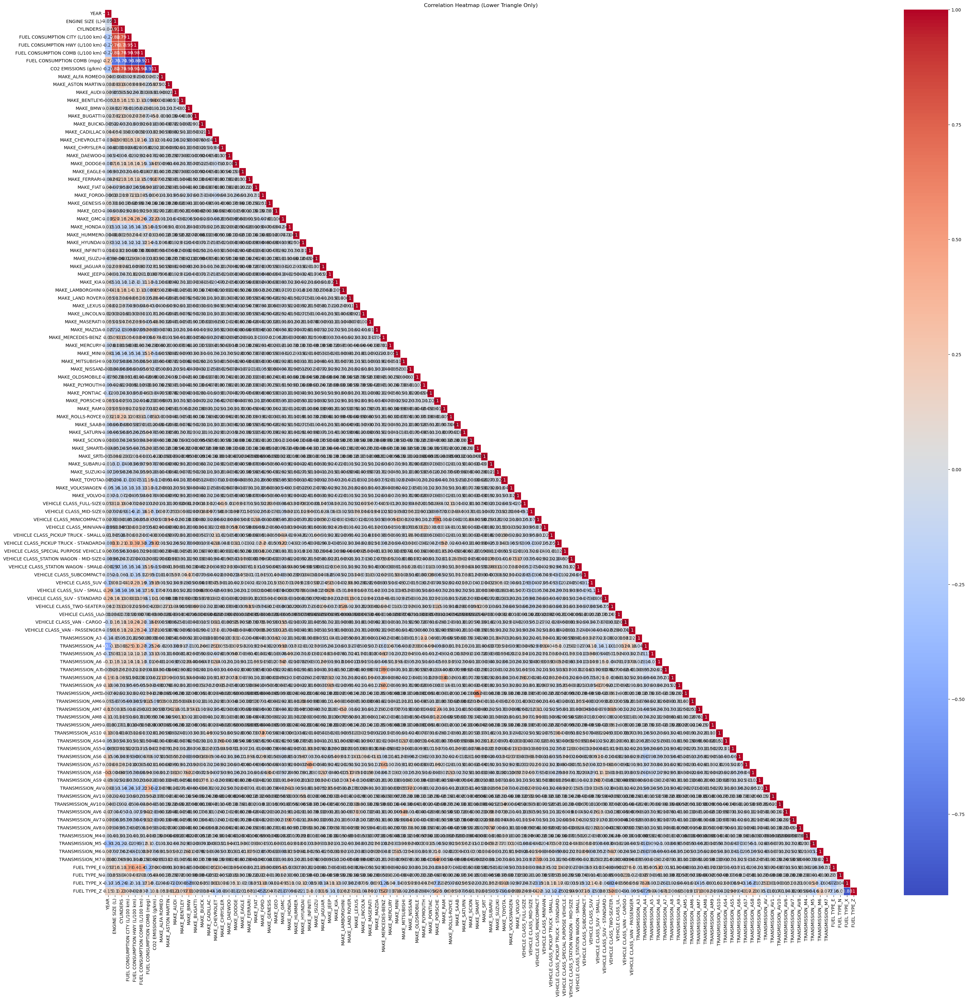

In [187]:
# Create a heatmap
plt.figure(figsize=(38, 36))
sns.heatmap(cars_df4.corr(), annot=True, cmap='coolwarm', linewidths=.5, mask=mask)
plt.title('Correlation Heatmap (Lower Triangle Only)')
plt.show()

As there are 112 columns, it is difficult to interpret the heatmap. However, most of the columns are the dummy variables for the categorical columns that were turned to numerical.

In [188]:
cars_df4.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27049 entries, 0 to 27051
Columns: 112 entries, YEAR to FUEL TYPE_Z
dtypes: float64(4), int32(104), int64(4)
memory usage: 12.6 MB


In [189]:
cars_df4.dtypes

YEAR                                  int64
ENGINE SIZE (L)                     float64
CYLINDERS                             int64
FUEL CONSUMPTION CITY (L/100 km)    float64
FUEL CONSUMPTION HWY (L/100 km)     float64
                                     ...   
TRANSMISSION_M7                       int32
FUEL TYPE_E                           int32
FUEL TYPE_N                           int32
FUEL TYPE_X                           int32
FUEL TYPE_Z                           int32
Length: 112, dtype: object

### Variance Inflation Factor (VIF)

Now that we cleaned the data, let's calculate the VIF to detect any collinearity. No scaling is needed in VIF. So data will be used as is.

#### Let's do this first for the numeric columns that we didn't convert with one-hot encoder 

In [99]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

In [191]:
# Extract the numeric columns for which you want to calculate VIF
numeric_columns = cars_df4.select_dtypes(include=['float64', 'int64']).columns

In [192]:
# Create a DataFrame containing only the numeric columns
numeric_data = cars_df4[numeric_columns]

In [193]:
# Add a constant column to the numeric data
numeric_data_with_const = add_constant(numeric_data)


In [194]:
# Calculate VIF for each variable
vif_data = pd.DataFrame()
vif_data["Variable"] = numeric_data_with_const.columns
vif_data["VIF"] = [variance_inflation_factor(numeric_data_with_const.values, i) for i in range(numeric_data_with_const.shape[1])]


In [195]:
# 6. Print or inspect the VIF values
print(vif_data)

                           Variable           VIF
0                             const  79215.637920
1                              YEAR      1.223198
2                   ENGINE SIZE (L)      7.354904
3                         CYLINDERS      6.781704
4  FUEL CONSUMPTION CITY (L/100 km)   2991.546117
5   FUEL CONSUMPTION HWY (L/100 km)    964.535385
6  FUEL CONSUMPTION COMB (L/100 km)   7128.321756
7       FUEL CONSUMPTION COMB (mpg)      8.056632
8              CO2 EMISSIONS (g/km)     10.599108


As seen, there are multiple variables with VIF > 10, which suggests there are some multicollinearities

#### Now, let's include all columns

In [197]:
# Extract the numeric columns for which you want to calculate VIF
numeric_columns_all = cars_df4.select_dtypes(include=['float64', 'int64', 'int32']).columns

In [198]:
# Create a DataFrame containing only the numeric columns
numeric_data_all = cars_df4[numeric_columns]

In [199]:
# Add a constant column to the numeric data
numeric_data_with_const_all = add_constant(numeric_data_all)


In [200]:
# Calculate VIF for each variable
vif_data_all = pd.DataFrame()
vif_data_all["Variable"] = numeric_data_with_const_all.columns
vif_data_all["VIF"] = [variance_inflation_factor(numeric_data_with_const_all.values, i) for i in range(numeric_data_with_const_all.shape[1])]

In [203]:
# Print or inspect the VIF values
print(vif_data_all)

                             Variable            VIF
0                               const  268416.250110
1                                YEAR       4.211166
2                     ENGINE SIZE (L)      12.153617
3                           CYLINDERS      10.450362
4    FUEL CONSUMPTION CITY (L/100 km)    3057.895087
..                                ...            ...
108                   TRANSMISSION_M7       1.861573
109                       FUEL TYPE_E      47.258747
110                       FUEL TYPE_N       1.872104
111                       FUEL TYPE_X      31.476460
112                       FUEL TYPE_Z      31.324457

[113 rows x 2 columns]


In [229]:
vif_data_all.head(10)

,Variable,VIF
0,const,268416.250110
1,YEAR,4.211166
2,ENGINE SIZE (L),12.153617
3,CYLINDERS,10.450362
4,FUEL CONSUMPTION CITY (L/100 km),3057.895087
5,FUEL CONSUMPTION HWY (L/100 km),996.742794
6,FUEL CONSUMPTION COMB (L/100 km),7380.454121
7,FUEL CONSUMPTION COMB (mpg),13.185687
8,CO2 EMISSIONS (g/km),193.474944
9,MAKE_ALFA ROMEO,1.237686


# Modelling

Now that EDA is done, we can start exploring models. Let's start by splitting the data into train and test sets.

The target variable is CO2 emissions - that is the y variable. 


In [136]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

In [137]:
# Extract features (X) and target variable (y)
X = cars_df1.drop('CO2 EMISSIONS (g/km)', axis=1)  # Features
y = cars_df1['CO2 EMISSIONS (g/km)']  # Target variable


In [138]:
# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Print the shapes of the resulting sets
print("Training set shapes:", X_train.shape, y_train.shape)
print("Testing set shapes:", X_test.shape, y_test.shape)


Training set shapes: (21639, 111) (21639,)
Testing set shapes: (5410, 111) (5410,)


## Linear Regression

The first model to explore will be linear regression.

In [218]:
# Initialize the linear regression model
model = LinearRegression()

In [219]:
# Fit the model to the training data
model.fit(X_train, y_train)

LinearRegression()

In [220]:
# Make predictions on the test data
y_pred = model.predict(X_test)

In [221]:
# Evaluate the model using mean squared error
mse = mean_squared_error(y_test, y_pred)

In [222]:
# Print the mean squared error
print(f"Mean Squared Error: {mse}")

# Print the coefficients and intercept
print("Coefficients:", model.coef_)
print("Intercept:", model.intercept_)

Mean Squared Error: 23.917327830945545
Coefficients: [ 1.11236376e-01  6.25416423e-01  1.90188806e-01  2.91803394e+00
  2.52995391e+00  1.51039011e+01 -8.54100589e-01  1.46354026e+00
  2.57572077e+00  2.18754104e-01  6.37785882e+00  1.42264962e-01
  2.08615340e+01  1.38394691e+00  2.82520070e-01  1.39768328e+00
  1.81570705e+00  6.58794776e-01  2.28991612e+00  1.09255133e+00
  1.08631638e+01  2.17764496e+00  2.27760968e+00  3.52951548e+00
  2.91170521e+00  1.07718947e+00  1.26049526e+00  2.75909155e-01
  1.13670935e+00  6.91858039e-01  2.91891731e+00  5.22545515e-01
  1.28355485e+00  1.66282822e+00  6.77311736e+00  2.13314688e+00
  4.39980823e-03  7.96603506e-01  3.34033681e+00  8.39285647e-01
  1.55547024e+00  5.31121902e-01  1.20646512e+00 -1.36023255e-01
  7.61641265e-01  1.10839683e-01  8.54001044e-01  1.82696357e-01
  4.19190427e-01  3.54593256e-01  5.01511638e+00  6.59463148e-01
  3.28359991e-01  2.13471306e-01  1.67999456e+00  1.75427224e+00
  8.91834529e-02  2.49447255e-01  1.2

We can see from above that RMSE is 23.9.

This is the difference between y-test and y-pred. Y is CO2 emissions in g/km. Looking at CO2 emissions (g/km), we can see that the mean and median values are 276 and 268 g/km, respectively. Hence, an RMSE of 23.9 is not bad and is acceptable.

In [231]:
cars_df4['CO2 EMISSIONS (g/km)'].mean()

275.53074050796704

In [232]:
cars_df4['CO2 EMISSIONS (g/km)'].median()

268.0

In [234]:
# Calculate R-squared
r_squared = r2_score(y_test, y_pred)

print(f'R-squared: {r_squared}')

R-squared: 0.9947661879784662


The R-squared value is also close to 1, suggesting high accuracy. 

We need to make sure that the model is not overfitting. Below is the R-squared calculated for the training set, which is very similar to the test set.

In [235]:
# Predictions on the training set
y_train_pred = model.predict(X_train)

In [236]:
# Calculate R-squared for the training set
r2_train = r2_score(y_train, y_train_pred)
print(f'R-squared for training set: {r2_train}')

R-squared for training set: 0.9948411405723501


In [237]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [238]:
# Create a decision tree regressor
tree_reg = DecisionTreeRegressor(random_state=42)

In [230]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
scaler = StandardScaler()

In [239]:
# Train the model
tree_reg.fit(X_train, y_train)

DecisionTreeRegressor(random_state=42)

In [240]:
# Predict on the test set
y_pred = tree_reg.predict(X_test)

In [241]:
# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse}')
print(f'R-squared: {r2}')

Mean Squared Error: 6.076006366810433
R-squared: 0.9986703918016969
